# (A) Dependencies

In [254]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import matplotlib
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

# (B) Dataset
- [Data Raw Resource](http://lib.stat.cmu.edu/datasets/boston)

### Downloading the dataset via kaggle api
- [Kaggle  Dataset](https://www.kaggle.com/datasets/vikrishnan/boston-house-prices)

In [255]:
# Download kaggle api
!pip install -q kaggle

In [256]:
# Creat the convenient dir for token. (The system will seach this dir)
! mkdir ~/.kaggle

mkdir: cannot create directory ‘/root/.kaggle’: File exists


- Upload your kaggle token
- For creating a token
  - Sign in your Kaggle account,
  - Open Account section from  your icon menu
  - Scroll to API section
  -  Click on __Create New API Token__
     - It will download kaggle.json file on your machine. 
  - Upload this kaggle.json file into your working directory on your google colab session.
  - Run floowing codes

In [257]:
# upload your kaggle token to download dataset.
from google.colab import files
files.upload();

Saving kaggle.json to kaggle.json


In [258]:
# Copy the json file into correct path, then remove the firt one it
! cp kaggle.json ~/.kaggle/
! rm -f kaggle.json

In [259]:
# Set the token can't readable for other user if you save it somewhere
! chmod 600 ~/.kaggle/kaggle.json

In [260]:
# Download your data "Competition-name"
#! kaggle competitions download -c 'competition-name'
!kaggle datasets download -d vikrishnan/boston-house-prices

boston-house-prices.zip: Skipping, found more recently modified local copy (use --force to force download)


In [314]:
!unzip boston-house-prices

Archive:  boston-house-prices.zip
  inflating: housing.csv             


In [315]:
!ls

boston-house-prices.zip  examples.pkl  sample_data
catboost_info		 flagged       scaler.pkl
component_configs.json	 housing.csv   xgbr_model.sav


## Loading the dataset

In [316]:
columns = ["crim", "zn", "indus", "chas", "nox", "rm", "age", "dis", "rad", "tax", "ptratio", "black", "lstat", "medv"]

In [317]:
df = pd.read_csv('housing.csv', header=None, delimiter=r"\s+",names=columns)
target_var = "medv"
df.head()

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
0,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296.0,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242.0,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242.0,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222.0,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222.0,18.7,396.90,5.33,36.2


## Dataset Information


Boston House Prices Dataset was collected in 1978 and has 506 entries with 14 attributes or features for homes from various suburbs in Boston.

```
Boston Housing Dataset Attribute Information (in order):
        - CRIM     per capita crime rate by town
        - ZN       proportion of residential land zoned for lots over 25,000 sq.ft.
        - INDUS    proportion of non-retail business acres per town
        - CHAS     Charles River dummy variable (= 1 if tract bounds river; 0 otherwise)
        - NOX      nitric oxides concentration (parts per 10 million)
        - RM       average number of rooms per dwelling
        - AGE      proportion of owner-occupied units built prior to 1940
        - DIS      weighted distances to five Boston employment centres
        - RAD      index of accessibility to radial highways
        - TAX      full-value property-tax rate per $10,000
        - PTRATIO  pupil-teacher ratio by town
        - B        1000(Bk - 0.63)^2 where Bk is the proportion of blacks by town
        - LSTAT    % lower status of the population
        - MEDV     Median value of owner-occupied homes in $1000's
```

## Attributes & Stats of the dataset

In [318]:
# statistical info
df.describe()

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
count,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000,506.000000
mean,3.613524,11.363636,11.136779,0.069170,0.554695,6.284634,68.574901,3.795043,9.549407,408.237154,18.455534,356.674032,12.653063,22.532806
std,8.601545,23.322453,6.860353,0.253994,0.115878,0.702617,28.148861,2.105710,8.707259,168.537116,2.164946,91.294864,7.141062,9.197104
min,0.006320,0.000000,0.460000,0.000000,0.385000,3.561000,2.900000,1.129600,1.000000,187.000000,12.600000,0.320000,1.730000,5.000000
25%,0.082045,0.000000,5.190000,0.000000,0.449000,5.885500,45.025000,2.100175,4.000000,279.000000,17.400000,375.377500,6.950000,17.025000
50%,0.256510,0.000000,9.690000,0.000000,0.538000,6.208500,77.500000,3.207450,5.000000,330.000000,19.050000,391.440000,11.360000,21.200000
75%,3.677083,12.500000,18.100000,0.000000,0.624000,6.623500,94.075000,5.188425,24.000000,666.000000,20.200000,396.225000,16.955000,25.000000
max,88.976200,100.000000,27.740000,1.000000,0.871000,8.780000,100.000000,12.126500,24.000000,711.000000,22.000000,396.900000,37.970000,50.000000


In [319]:
# datatype of attributes
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   crim     506 non-null    float64
 1   zn       506 non-null    float64
 2   indus    506 non-null    float64
 3   chas     506 non-null    int64  
 4   nox      506 non-null    float64
 5   rm       506 non-null    float64
 6   age      506 non-null    float64
 7   dis      506 non-null    float64
 8   rad      506 non-null    int64  
 9   tax      506 non-null    float64
 10  ptratio  506 non-null    float64
 11  black    506 non-null    float64
 12  lstat    506 non-null    float64
 13  medv     506 non-null    float64
dtypes: float64(12), int64(2)
memory usage: 55.5 KB


In [320]:
# check unique values in dataset
df.apply(lambda x: len(x.unique()))

crim       504
zn          26
indus       76
chas         2
nox         81
rm         446
age        356
dis        412
rad          9
tax         66
ptratio     46
black      357
lstat      455
medv       229
dtype: int64

In [321]:
# Subvalues of the categorical datas
for col in df.select_dtypes(include=["object"]):
    print(f"{col}\n" ,df[col].value_counts(), end="\n"*2)

In [322]:
# Converting the object dtype
# from pandas.api.types import CategoricalDtype
# for col in df.select_dtypes(include=["object"]):
#   df[col] = df[col].astype("category") # nominal
#   df[col] = df[col].astype( CategoricalDtype(categories=["b", "c", "d"], ordered=True) ) # ordinal


<Axes: xlabel='medv', ylabel='Density'>

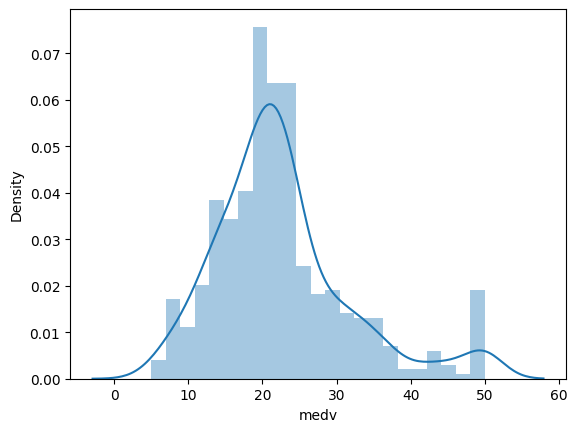

In [323]:
sns.distplot(df[target_var])

# (C) Preprocessing the dataset

## (1) Quick (EDA) Checks

### Checking the Variable Relations
- Checking the Variable Relations for deterninating variables which we will be focued on 

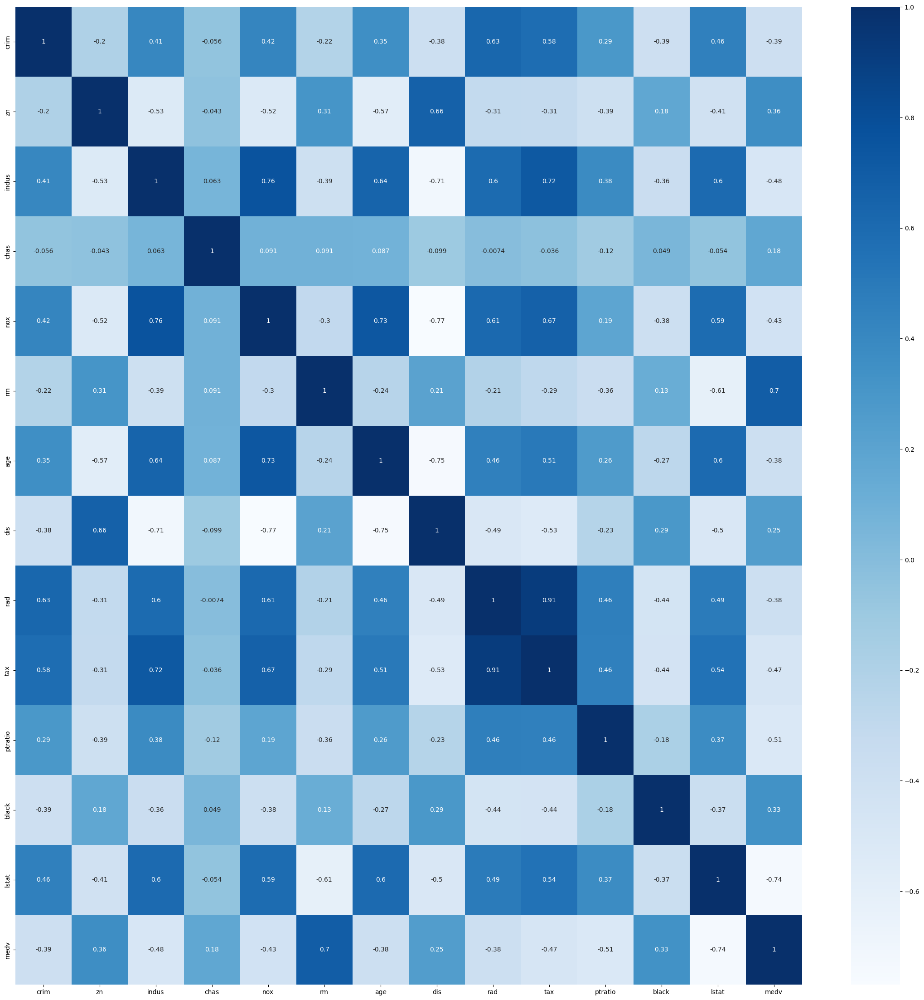

In [324]:
# Extracting the relations
corr = df.corr()

# Configurating plot
col_size = len(df.columns)
plt.figure(figsize=(col_size*2,col_size*2))

# Plotting
sns.heatmap(corr, annot=True, cmap="Blues");

Text(0.5, 1.0, 'Negative Correlation (neg> 0.7)')

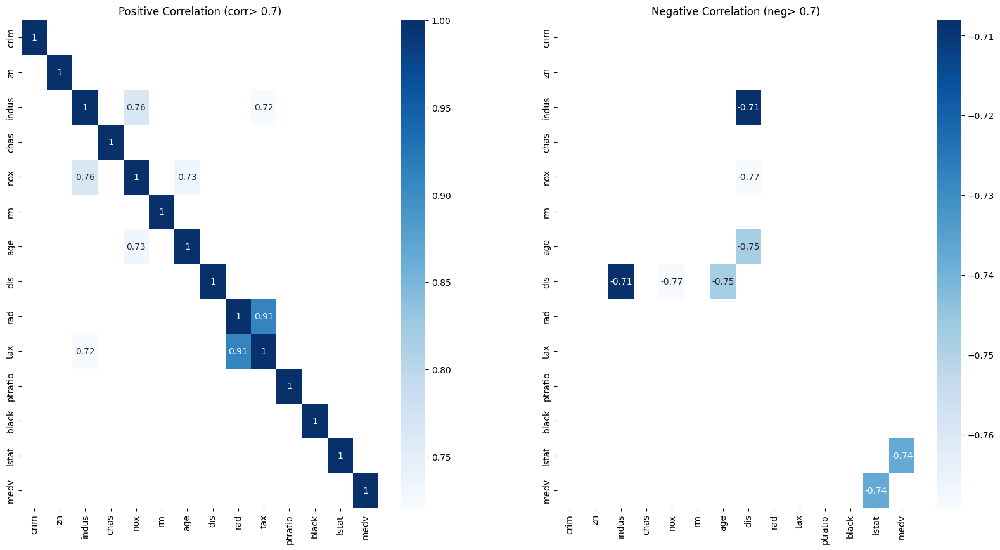

In [325]:
# Extracting the pos & neg corrs
p_th = 0.7
positive = corr[corr>p_th]

n_th = -0.7
negative = corr[corr<n_th]

# Configurating plot
col_size = len(df.columns)
plt.figure(figsize=(20,10))

# plotting as multiple axis
plt.subplot(1,2,1)
sns.heatmap(positive, annot=True, cmap="Blues");
plt.title("Positive Correlation (corr> 0.7)")

plt.subplot(1,2,2)
sns.heatmap(negative, annot=True, cmap="Blues");
plt.title("Negative Correlation (neg> 0.7)")

### Distribution Check

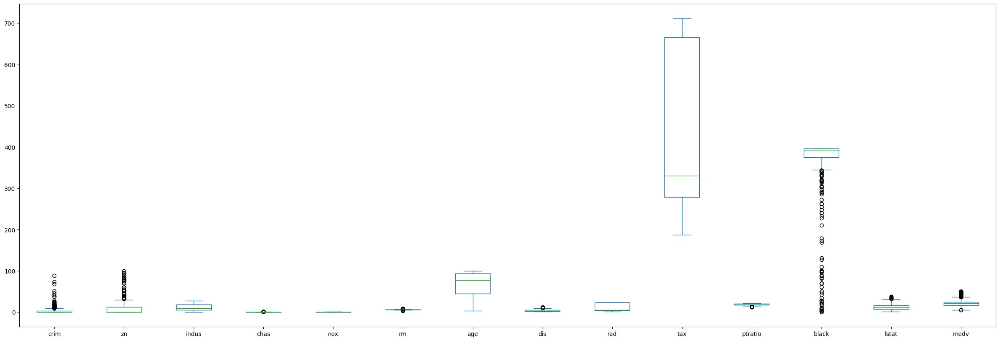

In [326]:
df.plot.box(figsize=(30,10));

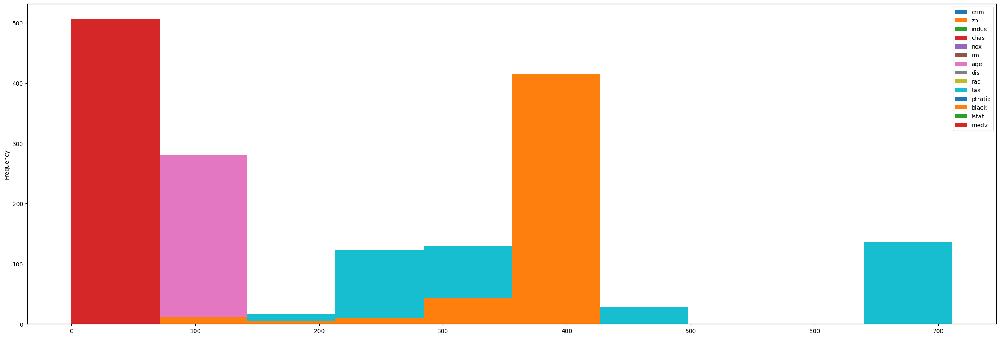

In [327]:
df.plot.hist(figsize=(30,10));

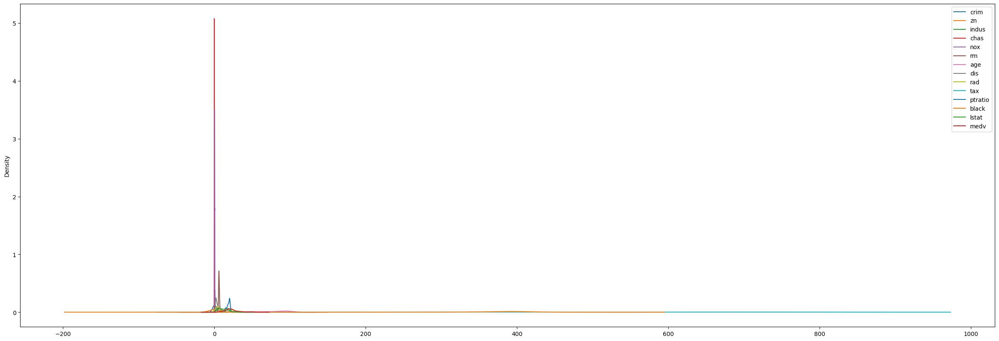

In [328]:
df.plot.kde(figsize=(30,10));

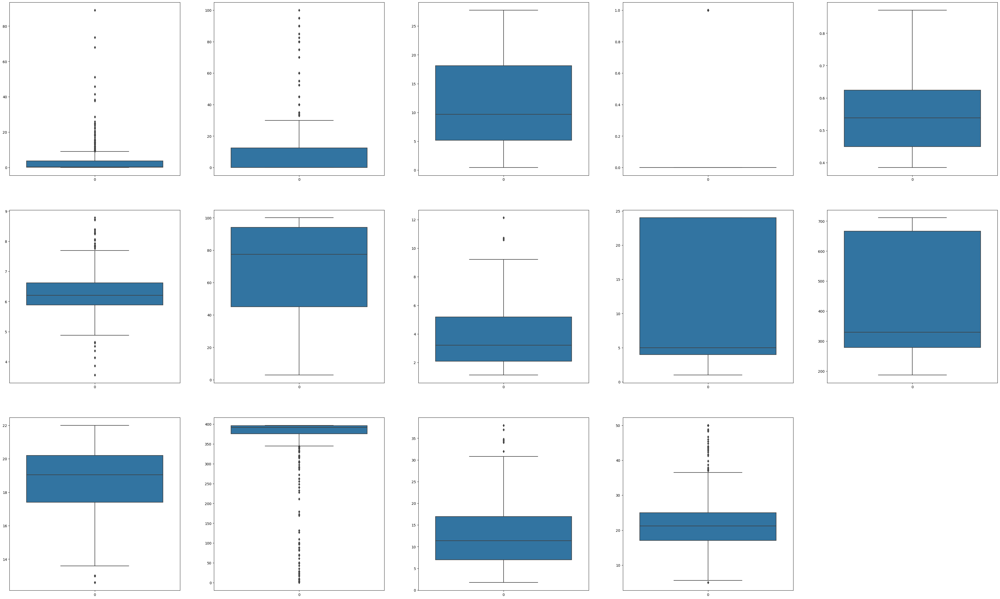

In [329]:
size = len(df.columns)
cs, rs = (5, size//5+1) if size >=5 else (3, size//3+1)

plt.figure(figsize=(cs*10, rs*10))
for i, col in enumerate(df.columns):
  plt.subplot(rs,cs,i+1)
  sns.boxplot(df[col])
  

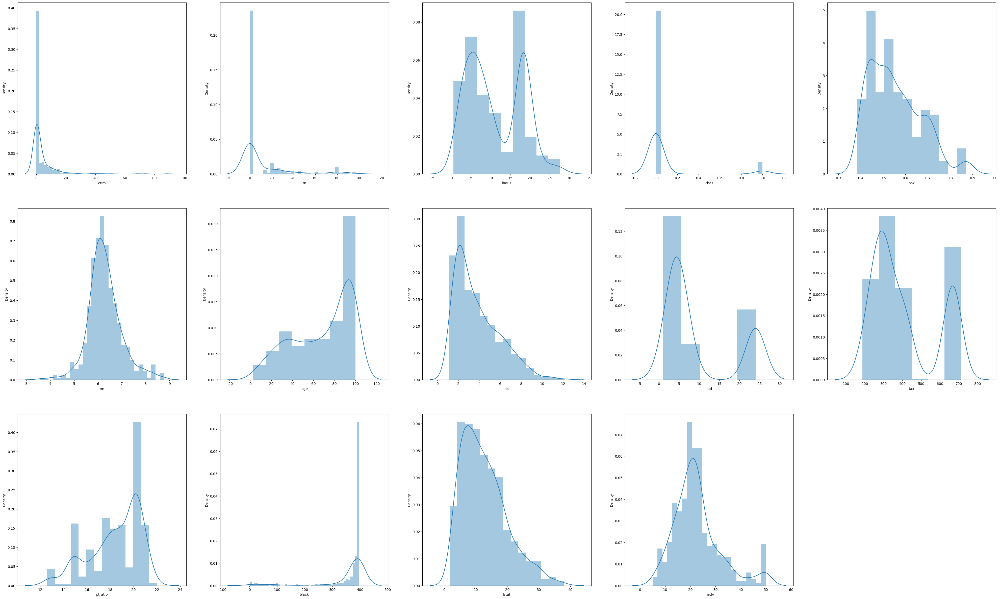

In [330]:
size = len(df.columns)
cs, rs = (5, size//5+1) if size >=5 else (3, size//3+1)

plt.figure(figsize=(cs*10, rs*10))
for i, col in enumerate(df.columns):
  plt.subplot(rs,cs,i+1)
  sns.distplot(df[col])

<Axes: xlabel='medv', ylabel='Density'>

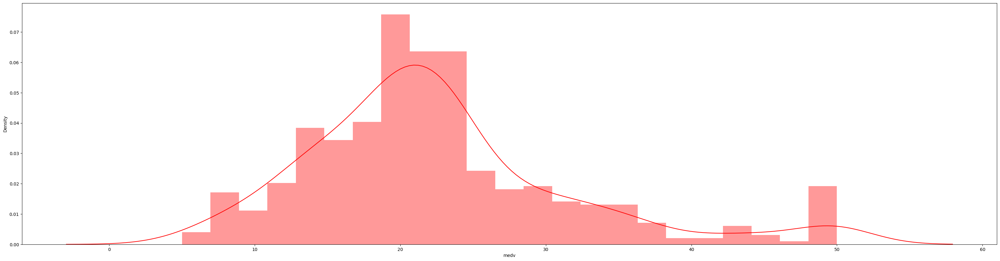

In [331]:
# Configurating plotings
plt.figure(figsize=(40,10))

sns.distplot( df[target_var], color='r')

## (2) Missing Value 

### Finding out the missing values

In [332]:
# find the null values
df.isnull().sum()

crim       0
zn         0
indus      0
chas       0
nox        0
rm         0
age        0
dis        0
rad        0
tax        0
ptratio    0
black      0
lstat      0
medv       0
dtype: int64

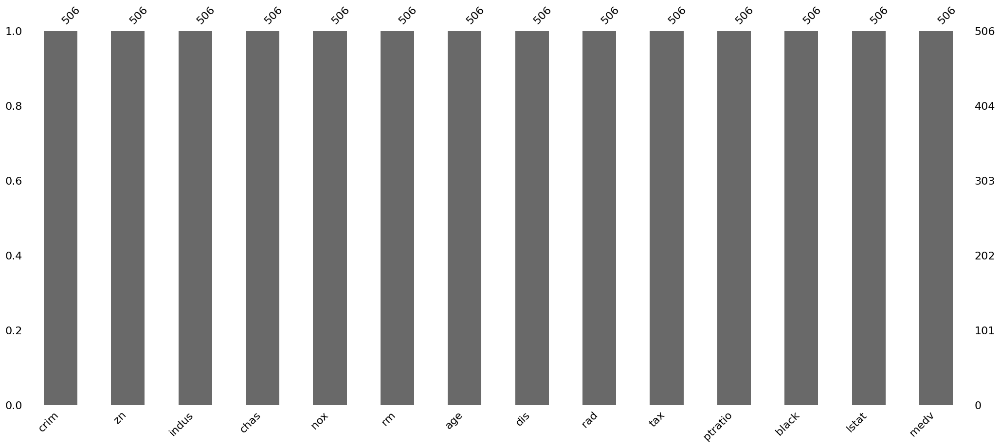

In [333]:
import missingno as msno
msno.bar(df);

<Axes: >

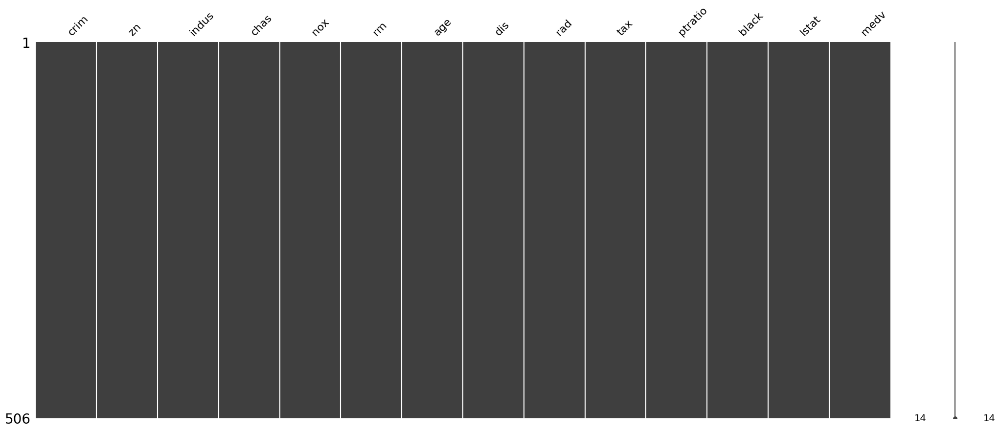

In [334]:
msno.matrix(df)

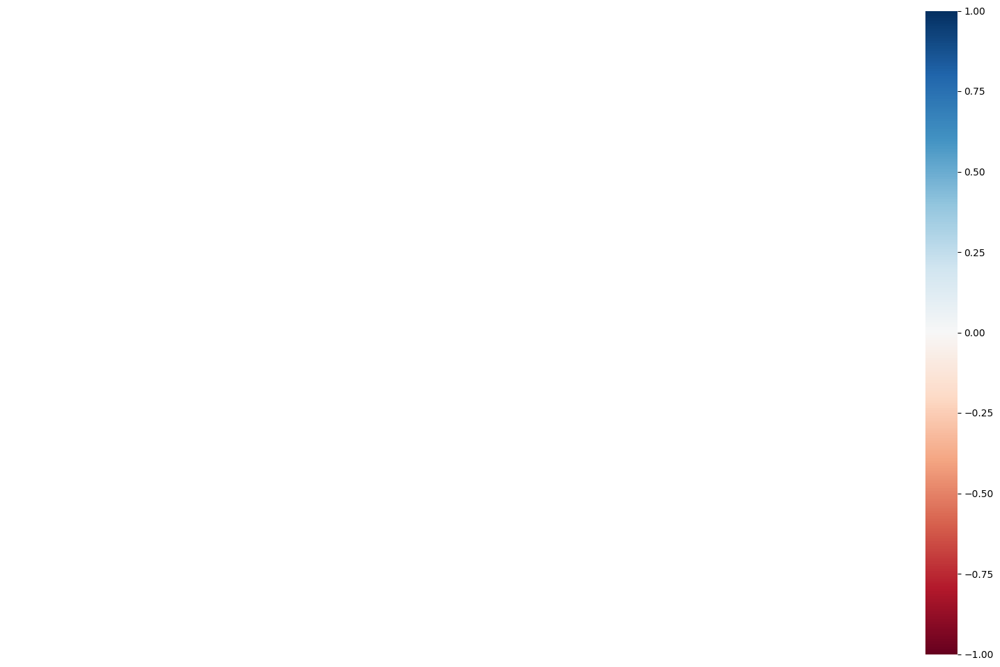

In [335]:
msno.heatmap(df);

### Handling The Missing Values
- There is no missin values, so no action implemented

## (3) Feature Engineering

#### Min-Max Scaling
Manuel Min-Max Scaling
```python
cols = ['crim', 'zn', 'tax', 'black']
for col in cols:
    # find minimum and maximum of that column
    minimum = min(df[col])
    maximum = max(df[col])
    df[col] = (df[col] - minimum) / (maximum - minimum)
```

```python
fig, ax = plt.subplots(ncols=7, nrows=2, figsize=(20, 10))
index = 0
ax = ax.flatten()

for col, value in df.items():
    sns.distplot(value, ax=ax[index])
    index += 1
plt.tight_layout(pad=0.5, w_pad=0.7, h_pad=5.0)
```

In [336]:
# standardization
from sklearn import preprocessing
scalar = preprocessing.StandardScaler()

# 
scale_cols = ['crim', 'zn', 'tax', 'black']

# Scaling the data
scaled_cols = scalar.fit_transform(df[scale_cols])
scaled_cols = pd.DataFrame(scaled_cols, columns=scale_cols)
scaled_cols.head()

,crim,zn,tax,black
0,-0.419782,0.284830,-0.666608,0.441052
1,-0.417339,-0.487722,-0.987329,0.441052
2,-0.417342,-0.487722,-0.987329,0.396427
3,-0.416750,-0.487722,-1.106115,0.416163
4,-0.412482,-0.487722,-1.106115,0.441052


In [337]:
with open("scaler.pkl","wb") as f: pickle.dump(scalar,f)

In [338]:
pickle.load(open("scaler.pkl", 'rb'))

StandardScaler()

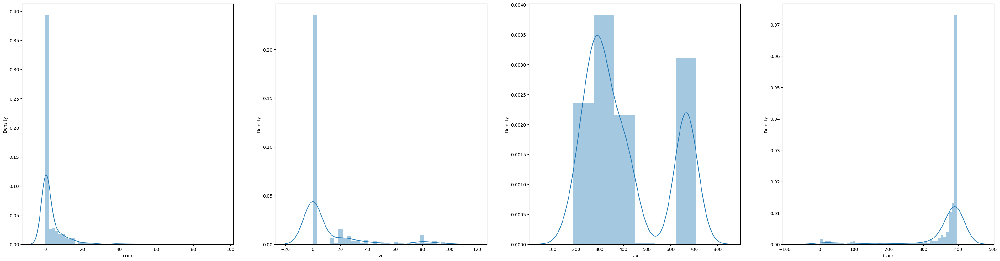

In [339]:
plt.figure(figsize=(40,10))
for i, col in enumerate(scale_cols):
  plt.subplot(1,4, i+1)
  sns.distplot(df[col])

In [340]:
# Saving the scaled values into out main dataset
for col in scale_cols: df[col] = scaled_cols[col]

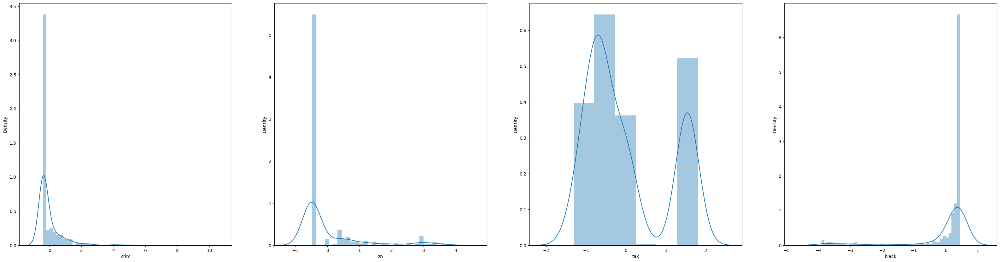

In [341]:
plt.figure(figsize=(40,10))
for i, col in enumerate(scale_cols):
  plt.subplot(1,4,i+1)
  sns.distplot(df[col])

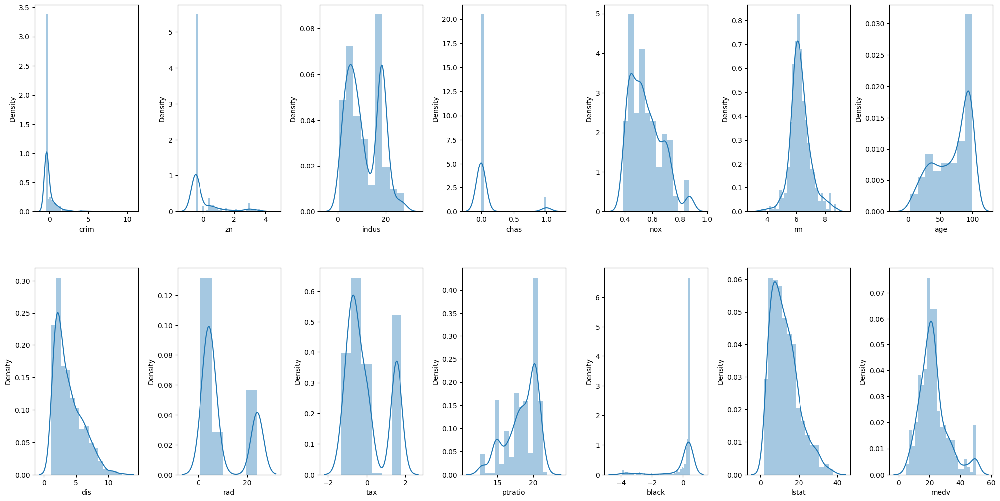

In [289]:
fig, ax = plt.subplots(ncols=7, nrows=2, figsize=(20, 10))
index = 0
ax = ax.flatten()

for col, value in df.items():
    sns.distplot(value, ax=ax[index])
    index += 1
plt.tight_layout(pad=0.5, w_pad=0.7, h_pad=5.0)

## (4) Outlier Analysis
- Outliers must be analyse according to re-sampling method because of to detect anomaly (Fraud Detection).

### Visual Approach

In [290]:
target_var = "medv"

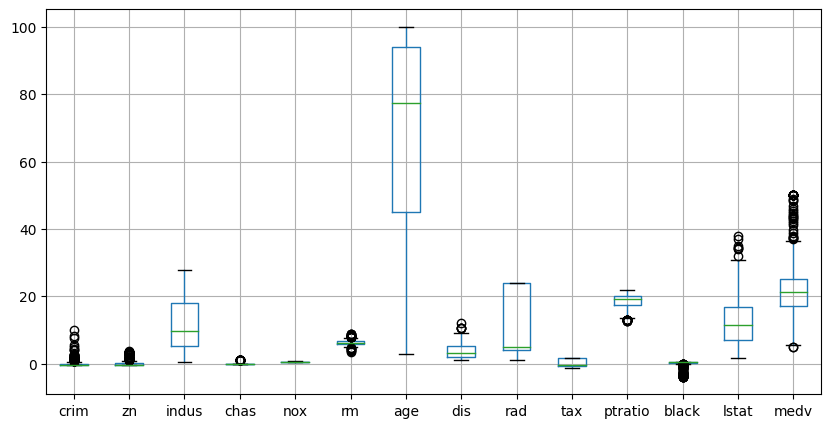

In [291]:
plt.figure(figsize=(10,5));
df.boxplot();

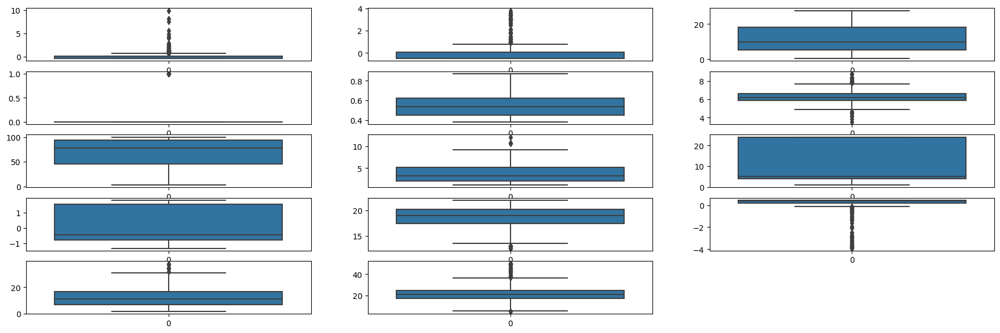

In [292]:
cum_col_sie = len(df.columns)

plt.figure(figsize=(22, 7))
for i, col in enumerate(df.columns):
  plt.subplot(5, cum_col_sie//5+1, i+1)
  sns.boxplot(df[col]);

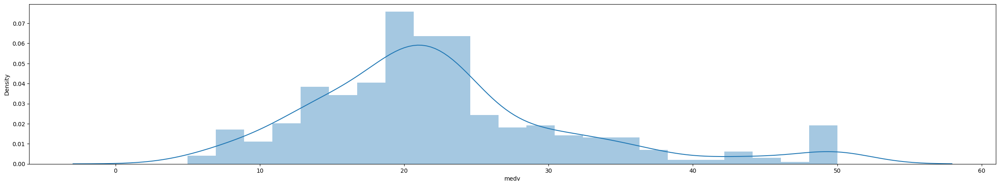

In [293]:
plt.figure(figsize=(30, 5))
sns.distplot(df[target_var]);

### IQR approach

- Note that
  - If you want to change a certain pertantage of the data for handling outliers.
    - You can adjust the ratio param forn  IQR_calculator funct to adjust inliar range.
  - If the ratio increate, 
    - outlier count will be reduce. Just the most outliers will be captured. 

#### Calculating IQR
- Calculates
  - __IQR__ pandas series for all the given variables
  - __l_th__ lower_threashold pandas series for all the given variables
  - __h_th__ higher_threashold pandas series for all the given variables

In [294]:
def IQR_calculator(df, ratio=1.5):
    # Calculating the quartiles
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    
    # IQR range calculation
    IQR = Q3 -Q1

    # Determinating the boundaries
    lower_threashold = Q1 - ratio * IQR
    higher_threashold = Q3 + ratio *IQR
    
    return IQR, lower_threashold, higher_threashold

In [295]:
IQR, l_th, h_th = IQR_calculator(df, ratio=1.5)

In [296]:
from pprint import pprint
for i in [IQR, l_th, h_th]:
  print("-"*20)
  pprint(i)
  print("-"*20, end="\n"*2)

--------------------
crim        0.418366
zn          0.536495
indus      12.910000
chas        0.000000
nox         0.175000
rm          0.738000
age        49.050000
dis         3.088250
rad        20.000000
tax         2.298502
ptratio     2.800000
black       0.228579
lstat      10.005000
medv        7.975000
dtype: float64
--------------------

--------------------
crim       -1.038519
zn         -1.292464
indus     -14.175000
chas        0.000000
nox         0.186500
rm          4.778500
age       -28.550000
dis        -2.532200
rad       -26.000000
tax        -4.215330
ptratio    13.200000
black      -0.137798
lstat      -8.057500
medv        5.062500
dtype: float64
--------------------

--------------------
crim         0.634946
zn           0.853514
indus       37.465000
chas         0.000000
nox          0.886500
rm           7.730500
age        167.650000
dis          9.820800
rad         54.000000
tax          4.978680
ptratio     24.400000
black        0.776520
lstat      

### Finding out The outlier values
- Finds __is_outlier__ and __is_outlier_val__ dataframes which include boolean value for ever individual value.

In [297]:
def find_outlier_single(data:pd.DataFrame, lower_threashold:float, higher_threashold:float)->pd.DataFrame:
    boolean_outlier_df = (data < lower_threashold) | (higher_threashold < data)
    return boolean_outlier_df

In [298]:
def find_outlier(df:pd.DataFrame, lower_threashold:pd.Series, higher_threashold:pd.Series)->pd.DataFrame:
    data = df[lower_threashold.index]
    boolean_outlier_df = (data < lower_threashold) | (higher_threashold < data)
    return boolean_outlier_df

In [299]:
# Getting the outlier indexes
is_outlier = find_outlier(df, l_th, h_th)
is_outlier.head()

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [300]:
is_outlier.sum()

crim       66
zn         68
indus       0
chas       35
nox         0
rm         30
age         0
dis         5
rad         0
tax         0
ptratio    15
black      77
lstat       7
medv       40
dtype: int64

In [301]:
outlier_ratios = (is_outlier.sum() / df[is_outlier.columns].count()).sort_values(ascending=False)
outlier_ratios

black      0.152174
zn         0.134387
crim       0.130435
medv       0.079051
chas       0.069170
rm         0.059289
ptratio    0.029644
lstat      0.013834
dis        0.009881
indus      0.000000
nox        0.000000
age        0.000000
rad        0.000000
tax        0.000000
dtype: float64

In [302]:
signf = 0.05
top_outlier =  outlier_ratios[outlier_ratios > signf]
top_outlier

black    0.152174
zn       0.134387
crim     0.130435
medv     0.079051
chas     0.069170
rm       0.059289
dtype: float64

In [342]:
IQR_2, l_th_2, h_th_2 = IQR_calculator(df, ratio=2)
is_outlier_2 = find_outlier(df, l_th_2, h_th_2)

outlier_ratios_2 = (is_outlier_2.sum() / df[is_outlier_2.columns].count()).sort_values(ascending=False)
top_outlier_2 =  outlier_ratios_2[outlier_ratios_2 > signf]
top_outlier_2

black    0.136364
zn       0.114625
crim     0.098814
chas     0.069170
medv     0.061265
dtype: float64

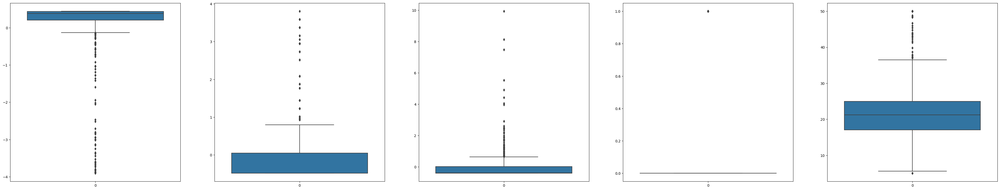

In [343]:
top_outlier_2_name = top_outlier_2.index
size=len(top_outlier_2_name)

cs, rs = (5, size//5+1) if size>=5 else (3, size//3+1) 

plt.figure(figsize=(cs*10,rs*10))
for i, col in enumerate(top_outlier_2_name):
  plt.subplot(rs, cs, i+1)
  sns.boxplot(df[col])

In [344]:
for col in top_outlier_2_name:
  print(f"{col:<8} number of unique values: {len(df[col].unique()):>5}")

black    number of unique values:   357
zn       number of unique values:    26
crim     number of unique values:   504
chas     number of unique values:     2
medv     number of unique values:   229


In [345]:
outlier_cols = ["black", "zn", "crim" ]    

### Handling outlier
- There are no outliers in the dataset, so no handling process is implemented

#### Util Functions

In [346]:
def mean_assignment(data:pd.Series, is_outlier:pd.Series, value:float):
  "It assigns given value to the outlier values"
  data[is_outlier] = value
  return data

# usage # df["c1"] = mean_assignment(df["c1"], is_outlier["c1"], df["c1"].mean()):

In [347]:
def boundary_casting(data:pd.Series, l_th:float, h_th:float):
  "It assigns border values to the outlier values"
  
  data[ data < l_th ] = l_th
  data[ h_th < data ] = h_th

  return data

In [348]:
df[is_outlier_2[outlier_cols[0]]][outlier_cols[0]].head()

18   -0.742112
25   -0.583896
27   -0.551442
32   -1.360392
34   -1.188142
Name: black, dtype: float64

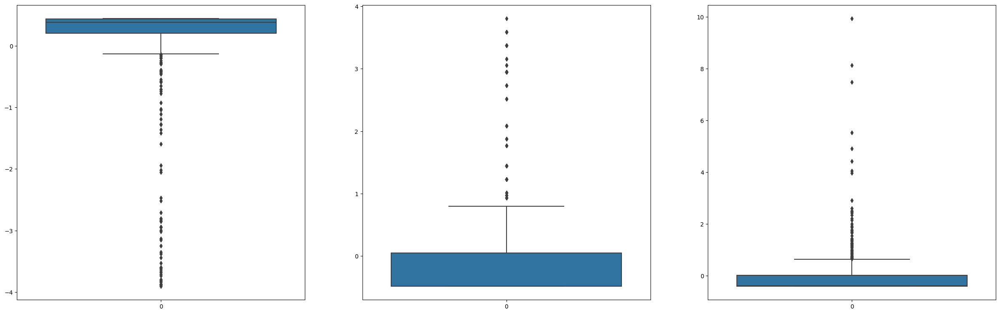

In [349]:
size=len(outlier_cols)
cs, rs = (5, size//5+1) if size>=5 else (3, size//3+1) 

plt.figure(figsize=(cs*10,rs*10))
for i, col in enumerate(outlier_cols):
  plt.subplot(rs, cs, i+1)
  sns.boxplot(df[col])

In [350]:
for col in outlier_cols:
  df[col] = boundary_casting(df[col], l_th_2[col], h_th_2[col])

In [351]:
df[is_outlier_2[outlier_cols[0]]][outlier_cols[0]].head()

18   -0.252087
25   -0.252087
27   -0.252087
32   -0.252087
34   -0.252087
Name: black, dtype: float64

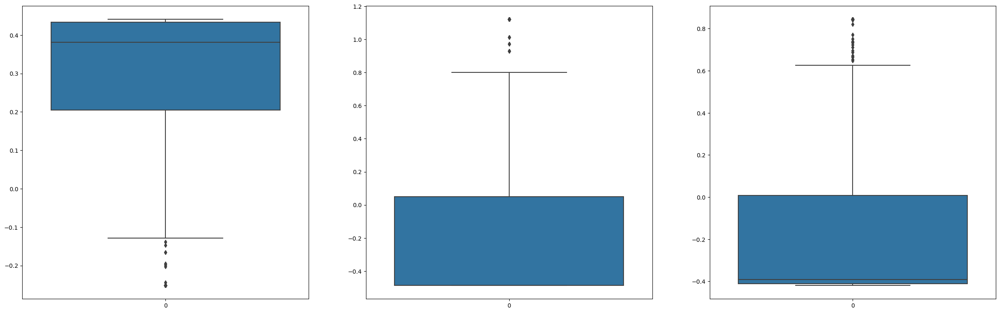

In [352]:
size=len(outlier_cols)
cs, rs = (5, size//5+1) if size>=5 else (3, size//3+1) 

plt.figure(figsize=(cs*10,rs*10))
for i, col in enumerate(outlier_cols):
  plt.subplot(rs, cs, i+1)
  sns.boxplot(df[col])

# (D) Exploratory Data Analysis

## Dataset 

### Spesifications

In [59]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   crim     506 non-null    float64
 1   zn       506 non-null    float64
 2   indus    506 non-null    float64
 3   chas     506 non-null    int64  
 4   nox      506 non-null    float64
 5   rm       506 non-null    float64
 6   age      506 non-null    float64
 7   dis      506 non-null    float64
 8   rad      506 non-null    int64  
 9   tax      506 non-null    float64
 10  ptratio  506 non-null    float64
 11  black    506 non-null    float64
 12  lstat    506 non-null    float64
 13  medv     506 non-null    float64
dtypes: float64(12), int64(2)
memory usage: 55.5 KB


In [60]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
crim,506.0,-0.138238,0.435946,-0.419782,-0.410970,-0.390667,0.007397,0.844129
zn,506.0,-0.155859,0.585588,-0.487722,-0.487722,-0.487722,0.048772,1.121761
indus,506.0,11.136779,6.860353,0.460000,5.190000,9.690000,18.100000,27.740000
chas,506.0,0.069170,0.253994,0.000000,0.000000,0.000000,0.000000,1.000000
nox,506.0,0.554695,0.115878,0.385000,0.449000,0.538000,0.624000,0.871000
rm,506.0,6.284634,0.702617,3.561000,5.885500,6.208500,6.623500,8.780000
age,506.0,68.574901,28.148861,2.900000,45.025000,77.500000,94.075000,100.000000
dis,506.0,3.795043,2.105710,1.129600,2.100175,3.207450,5.188425,12.126500
rad,506.0,9.549407,8.707259,1.000000,4.000000,5.000000,24.000000,24.000000
tax,506.0,0.000000,1.000990,-1.313990,-0.767576,-0.464673,1.530926,1.798194


In [61]:
pd.unique(df.select_dtypes(include=["object","category"]).values.ravel('k'))

array([], dtype=float64)

## Univariate Analysis

In [62]:
num_cols = df.select_dtypes(include=("int64","float64"), exclude=("bool") ).columns
cat_cols = df.select_dtypes(exclude=("int64","float64")).columns

In [63]:
num_cols

Index(['crim', 'zn', 'indus', 'chas', 'nox', 'rm', 'age', 'dis', 'rad', 'tax',
       'ptratio', 'black', 'lstat', 'medv'],
      dtype='object')

In [64]:
len(df.columns), df.columns

(14,
 Index(['crim', 'zn', 'indus', 'chas', 'nox', 'rm', 'age', 'dis', 'rad', 'tax',
        'ptratio', 'black', 'lstat', 'medv'],
       dtype='object'))

In [65]:
df[cat_cols].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Empty DataFrame


In [66]:
df[num_cols].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 506 entries, 0 to 505
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   crim     506 non-null    float64
 1   zn       506 non-null    float64
 2   indus    506 non-null    float64
 3   chas     506 non-null    int64  
 4   nox      506 non-null    float64
 5   rm       506 non-null    float64
 6   age      506 non-null    float64
 7   dis      506 non-null    float64
 8   rad      506 non-null    int64  
 9   tax      506 non-null    float64
 10  ptratio  506 non-null    float64
 11  black    506 non-null    float64
 12  lstat    506 non-null    float64
 13  medv     506 non-null    float64
dtypes: float64(12), int64(2)
memory usage: 55.5 KB


### Target Variable

In [67]:
target_var = "medv"

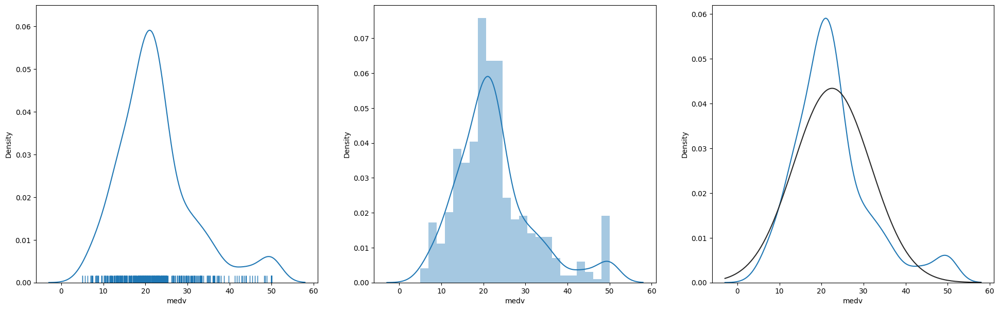

In [68]:
from scipy.stats import norm

plt.figure(figsize=(24,7))

plt.subplot(1,3,1)
sns.distplot(df[target_var], rug=True, hist=False);

plt.subplot(1,3,2)
sns.distplot(df[target_var], rug=False, hist=True);

plt.subplot(1,3,3)
sns.distplot(df[target_var], fit=norm, rug=False, hist=False);

### Feature Variables [Numerical]

#### setting the plotting params

In [200]:
# Defining the params
target_var = "medv"
#num_cols = df.select_dtypes(exclude='category').columns
num_col_size = len(num_cols)
cols, rows = (3, num_col_size//3 + 1) if num_col_size > 5 else (5, 1) 
figsize = (cols*7, rows*5)

#### [histplot] Distributions

In [70]:
num_cols

Index(['crim', 'zn', 'indus', 'chas', 'nox', 'rm', 'age', 'dis', 'rad', 'tax',
       'ptratio', 'black', 'lstat', 'medv'],
      dtype='object')

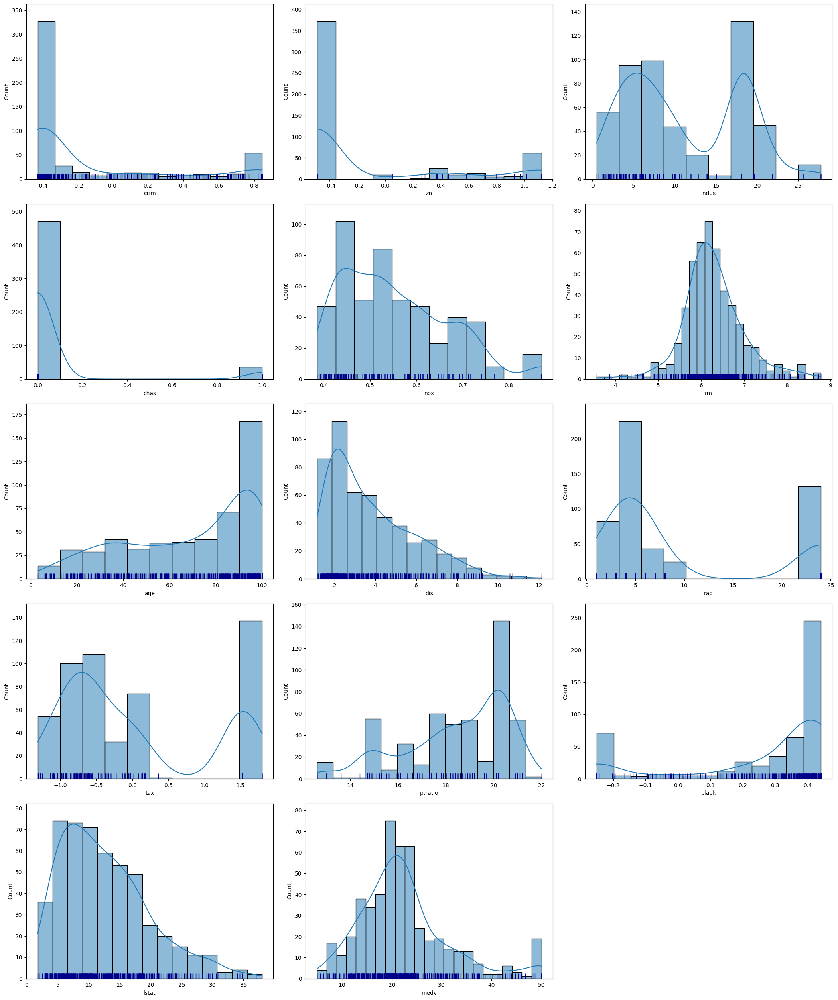

In [71]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    ax=fig.add_subplot(rows,cols,i+1)
    sns.histplot(x=df[col], data=df, kde=True, ax=ax)
    sns.rugplot(x=df[col], data=df, height=.03, color='darkblue', ax=ax)
    
fig.tight_layout()  
plt.show()

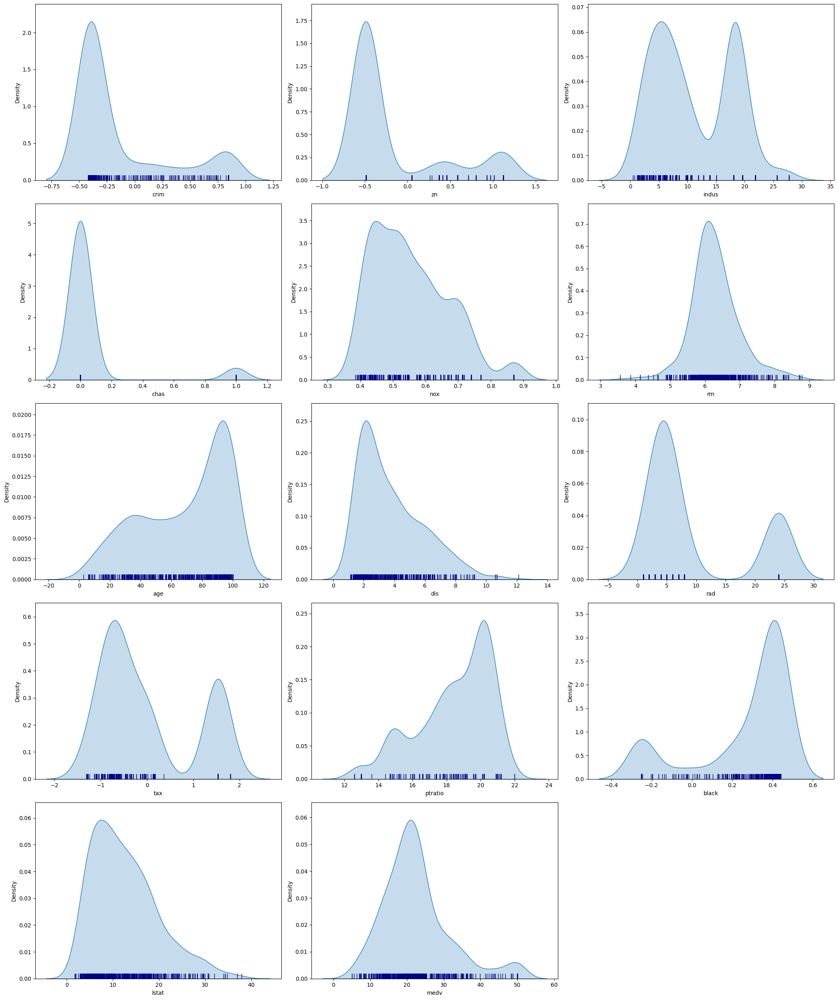

In [72]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    ax=fig.add_subplot(rows,cols,i+1)
    sns.kdeplot(x=df[col], data=df ,shade=True, ax=ax)
    sns.rugplot(x=df[col], data=df, height=.03, color='darkblue', ax=ax)
    
fig.tight_layout()  
plt.show()

#### [boxplot] Distributions with quartiles (Outlier)

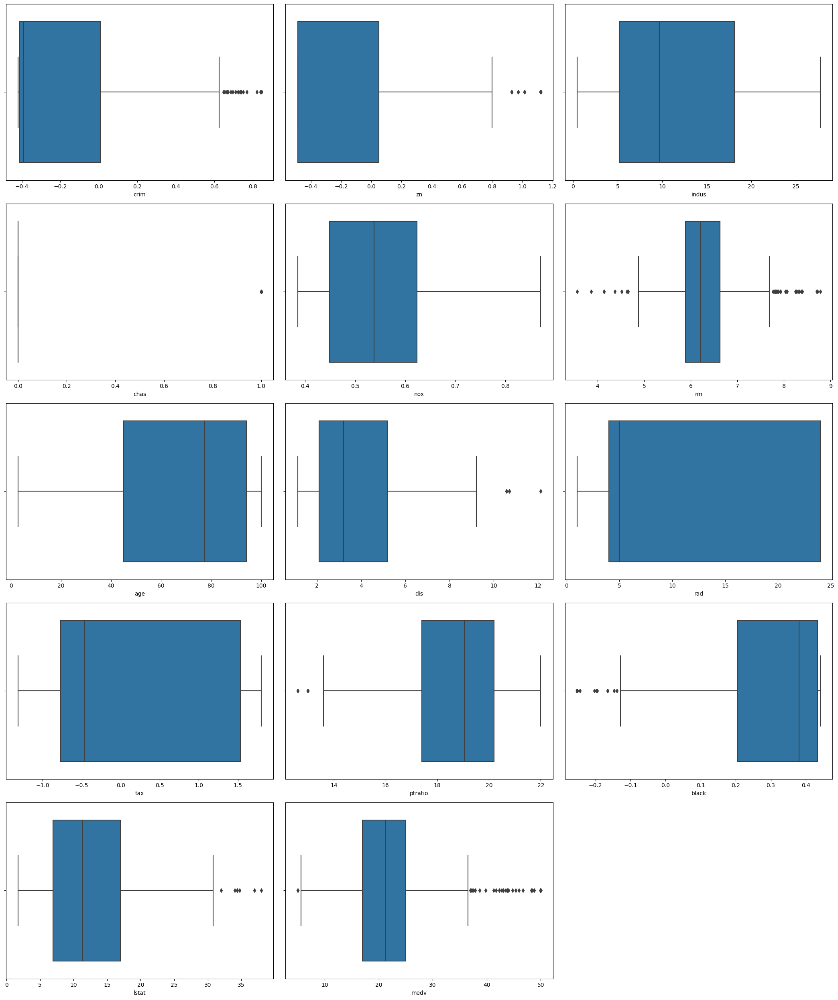

In [73]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # boxplot
    sns.boxplot(x=df[col], ax=ax)
    
fig.tight_layout()  
plt.show()

#### [violinplot] Distributions with quartiles and density

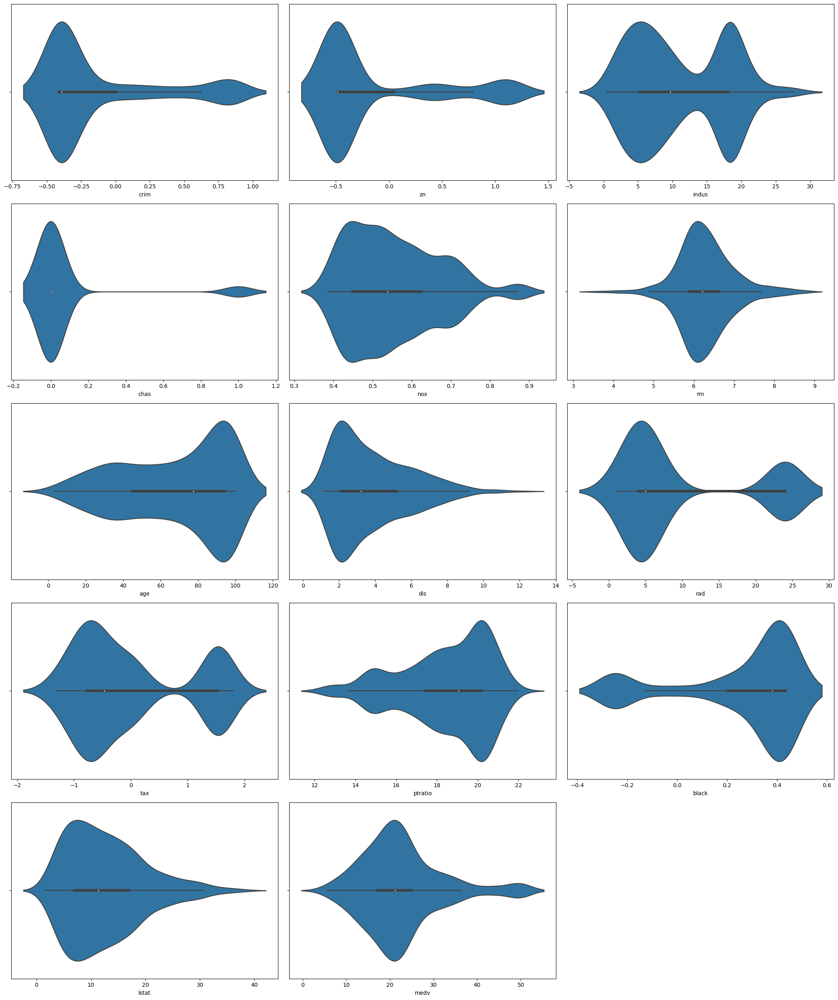

In [74]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # violinplot
    sns.violinplot(x=df[col], show_medians=True, ax=ax)
    
fig.tight_layout()  
plt.show()

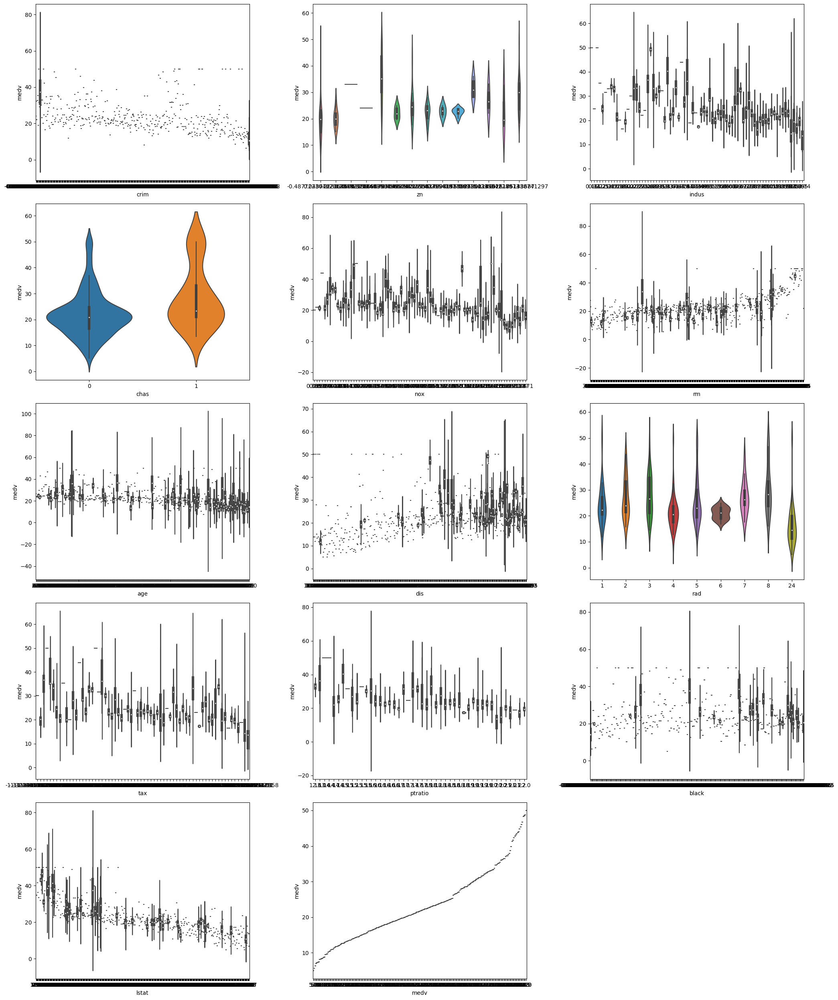

In [202]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # violinplot
    sns.violinplot(x=df[col],y=df[target_var], show_medians=True, ax=ax)
    
fig.tight_layout()  
plt.show()

#### [stripplot] spread of the data with stripplot

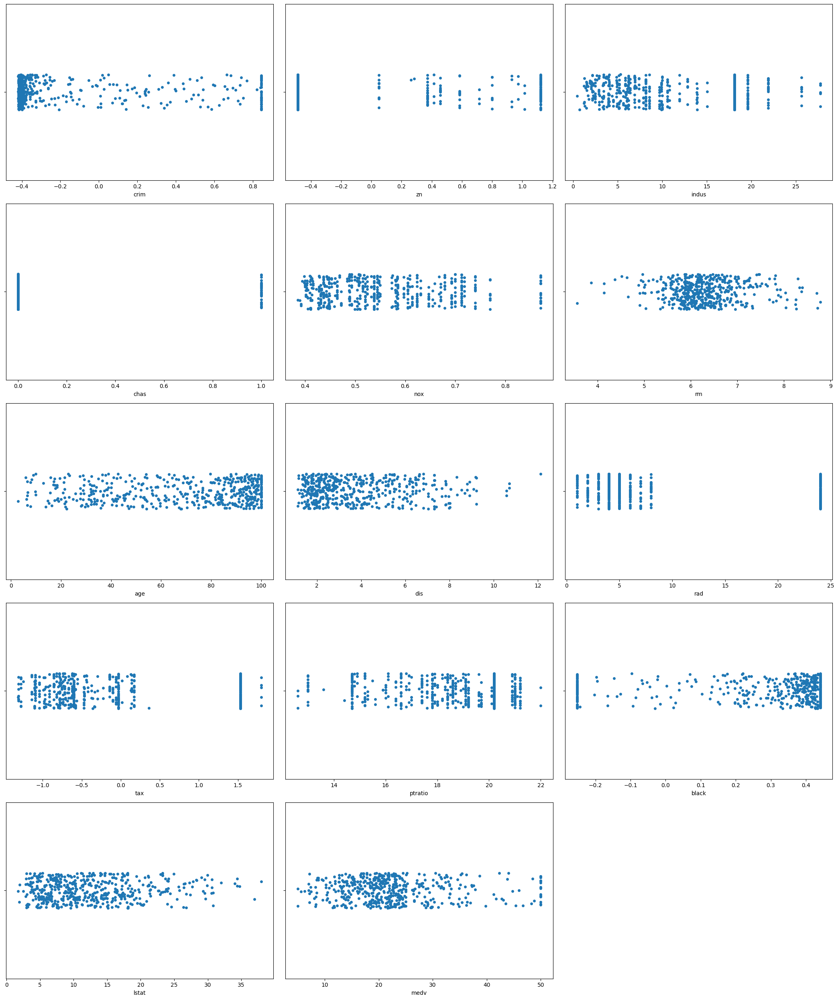

In [75]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # stripplot
    sns.stripplot(x=df[col], ax=ax)
    
fig.tight_layout()  
plt.show()

#### [swarmplot] spread of the data with stripplot (avoids overlap)
```python
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # swarmplot
    sns.swarmplot(x=df[col], ax=ax)
    
fig.tight_layout()  
plt.show()
```

#### [scatterplot] Spread of data 

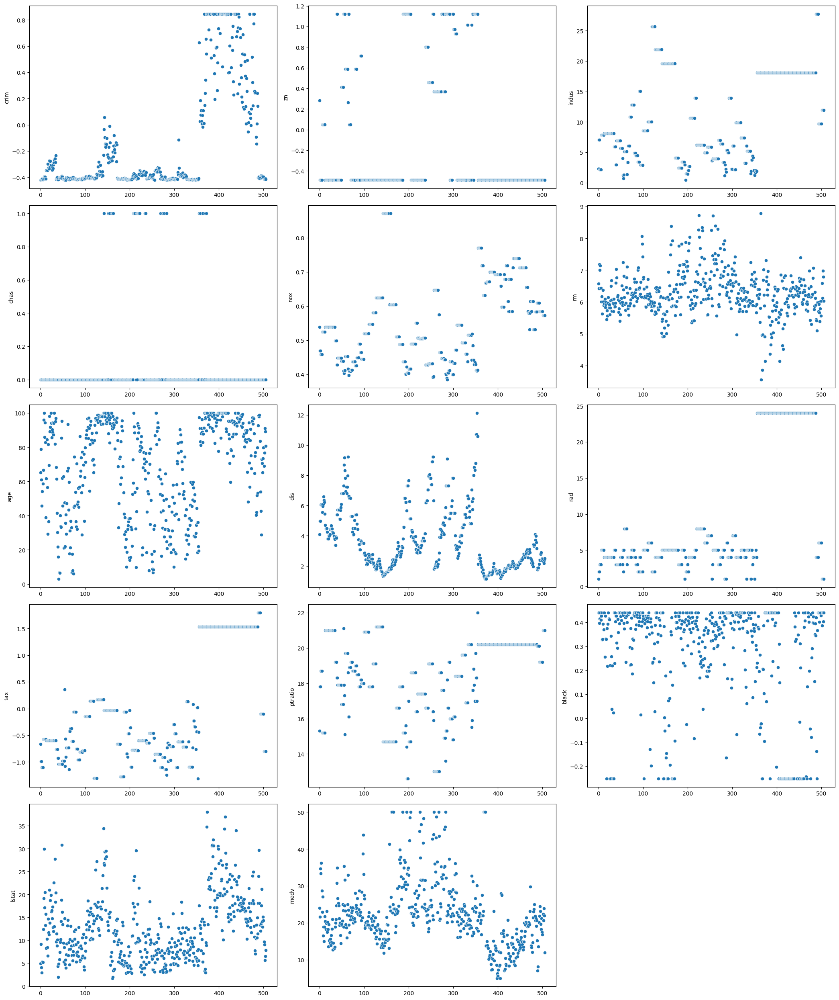

In [76]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # scatterplot
    sns.scatterplot(x = df[col].index, y= df[col], ax=ax)
    
fig.tight_layout()  
plt.show()

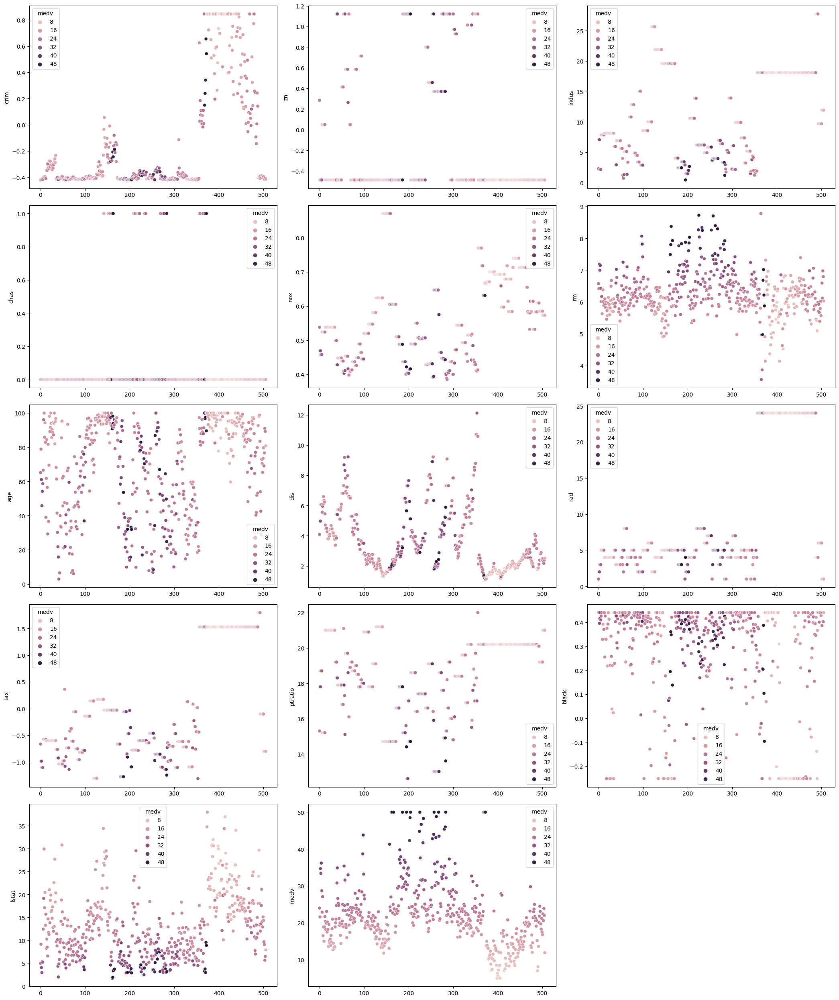

In [212]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # scatterplot
    sns.scatterplot(x = df[col].index, y= df[col], hue=df[target_var], ax=ax)
    
fig.tight_layout()  
plt.show()

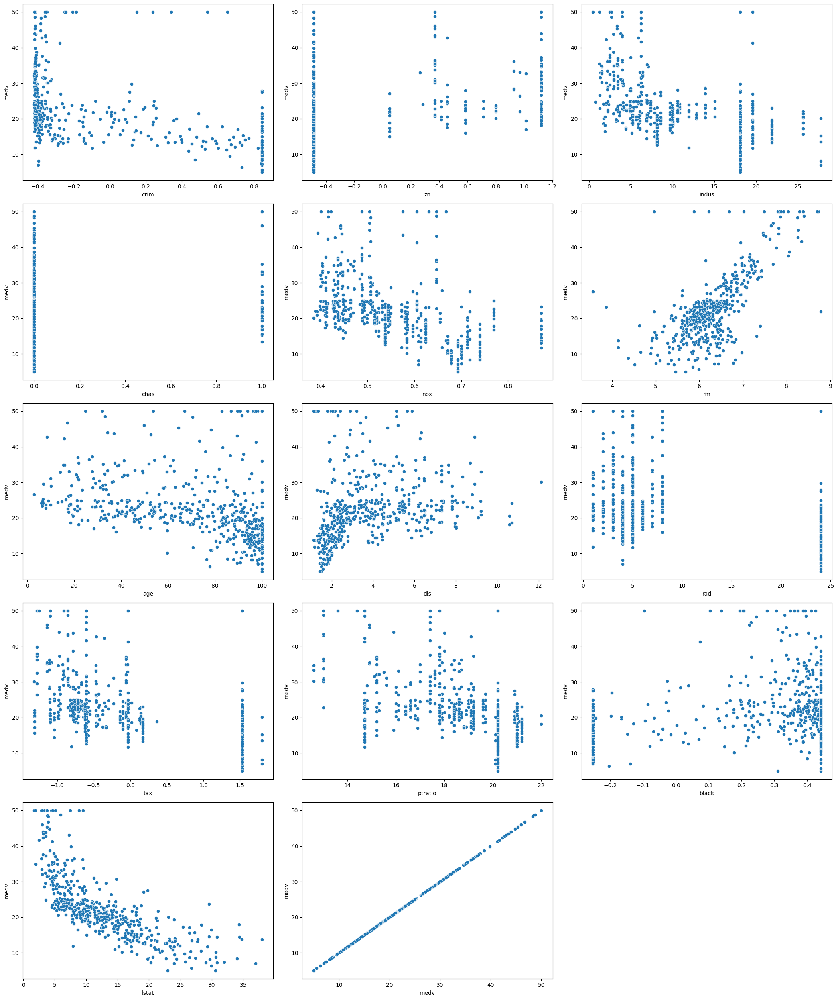

In [205]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # scatterplot
    sns.scatterplot(x = df[col], y= df[target_var], ax=ax)
    
fig.tight_layout()  
plt.show()

#### [lineplot] Trend

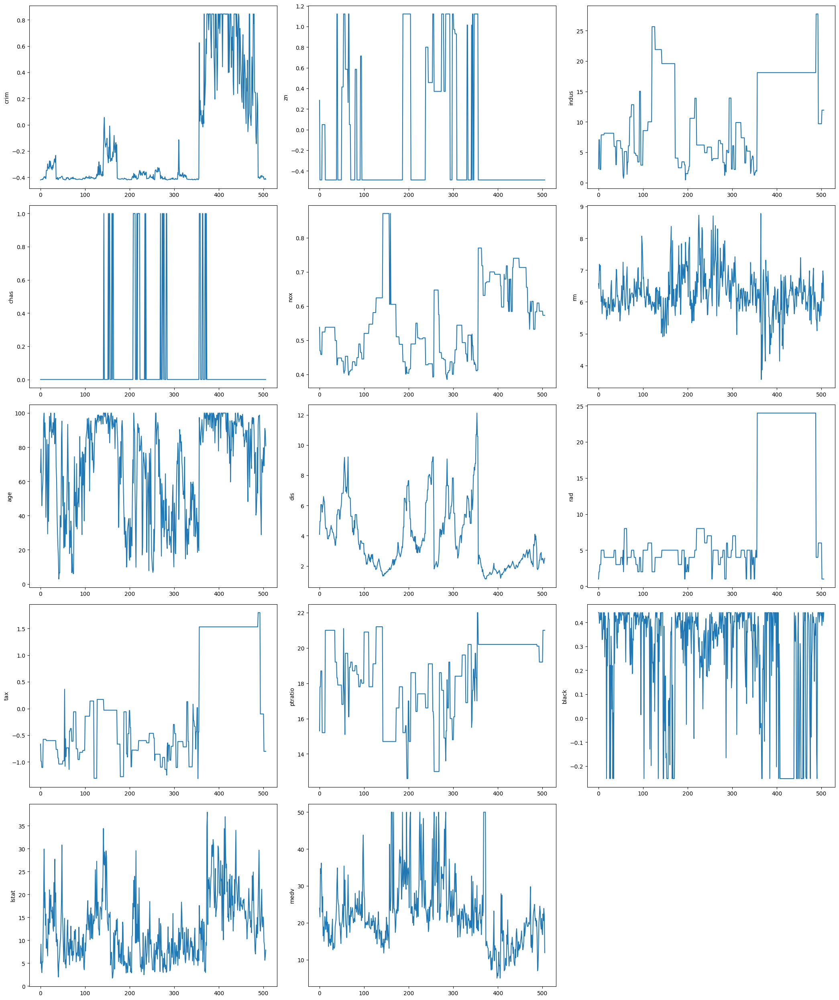

In [77]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(num_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # boxplot
    sns.lineplot(x=df[col].index, y=df[col], ax=ax)
    #sns.scatterplot(x = df[col].index, y= df[col], hue=df["species"], ax=ax)
    
fig.tight_layout()  
plt.show()

#### [PairPlot]

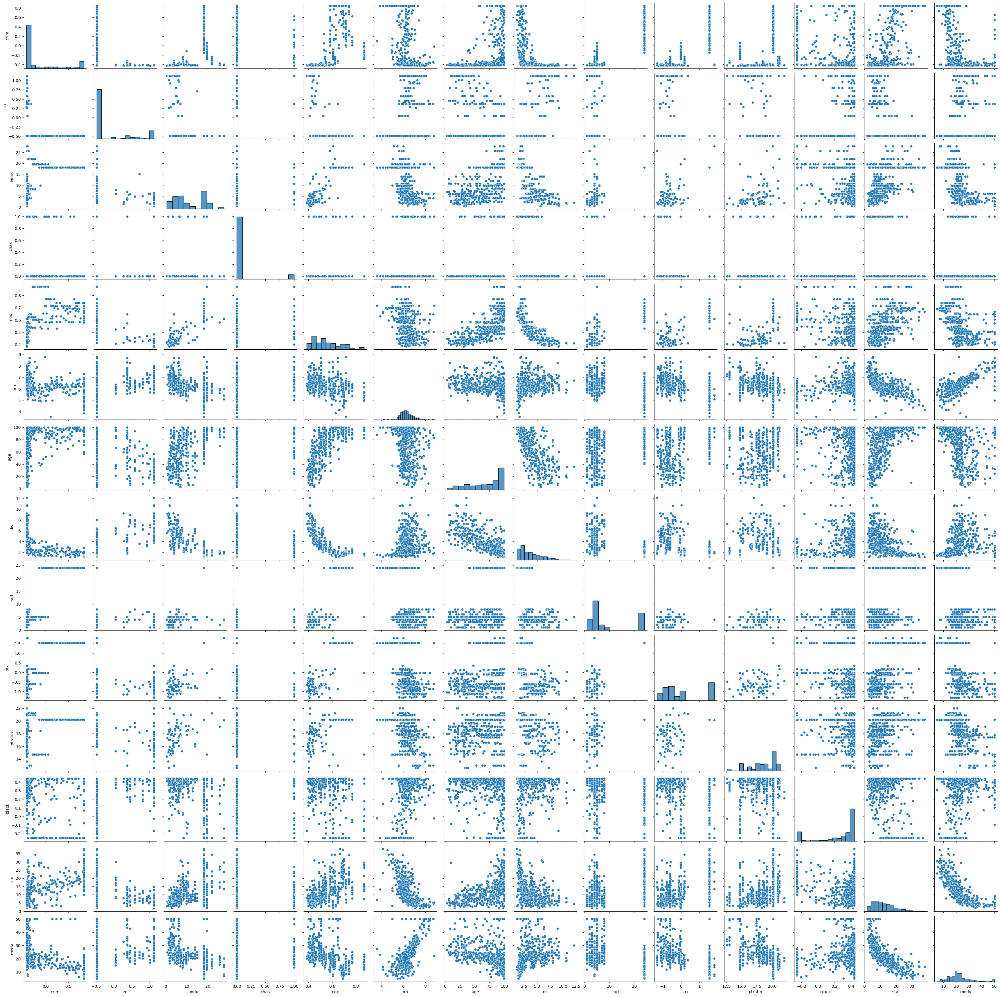

In [207]:
sns.pairplot(df)

### Feature Variables [Categorical]

#### setting the plotting params

In [78]:
# Defining the params
target_var = "medv"
#num_cols = df.select_dtypes(exclude='category').columns
cat_col_size = len(cat_cols)
cols, rows = (3, cat_col_size//3 + 1) if cat_col_size > 5 else (5, 1) 
figsize = (cols*7, rows*5)

In [79]:
cat_cols

Index([], dtype='object')

In [80]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(cat_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
    # boxplot
    sns.countplot(x=df[col], ax=ax)
    #sns.scatterplot(x = df[col].index, y= df[col], hue=df["species"], ax=ax)
    
fig.tight_layout()  
plt.show()

<Figure size 3500x500 with 0 Axes>

In [81]:
fig = plt.figure(figsize=figsize)
for i, col in enumerate(cat_cols):
    
    # creating new axis for plotting
    ax=fig.add_subplot( rows, cols, i+1)
    
  
    # boxplot
    plt.pie(df[col].value_counts(), labels=df[col].unique(), autopct="%.0f%%");
    #sns.scatterplot(x = df[col].index, y= df[col], hue=df["species"], ax=ax)
    
fig.tight_layout()  
plt.show()

<Figure size 3500x500 with 0 Axes>

## Relations

### Quick Variable Relation

In [82]:
def rel_filter(df:pd.DataFrame, th:float)->pd.DataFrame:
  # Calculating the relations
  corr = df.corr()

  # filtering the relations
  filtered_corr = corr[corr > th]  if th > 0.0 else corr[corr < th]

  return filtered_corr

def rel_plotter(corr:pd.DataFrame, title:str="Correlations", figsize:tuple=None, cmap="Blues", annot=True):
  
  # plotting configurations
  if figsize != None: plt.figure(figsize=figsize)

  # plotting the relattions
  sns.heatmap(corr, cmap="Blues", annot=True)
  plt.title(title);

def get_relations(corr:pd.DataFrame, th:float)->list:

  # decleration of params
  columns = corr.columns
  is_exceed = (lambda rel: rel > th)  if th > 0 else (lambda rel: rel < th)  

  # getting the column names which exceedes the threashold
  filtered_relations = list()
  for row in columns:
    for col in columns:
        
        # Pass the correaltion with itself
        if col==row: continue

        # Collect variables which exvide threashold correlation 
        cur_corr = corr.loc[row, col]
        if  is_exceed(cur_corr):

          # Check whether the record have already added
          is_already_added = [ all([ e in record for e in [row, col] ])  for record in filtered_relations ]
          
          # Add if it have not already added
          if not any(is_already_added): filtered_relations.append([row, col, np.round(cur_corr, 2)]) 
  
  return filtered_relations

In [83]:
get_relations(df.corr(), 0.85), get_relations(df.corr(), 0.85)

([['crim', 'rad', 0.91], ['crim', 'tax', 0.85], ['rad', 'tax', 0.91]],
 [['crim', 'rad', 0.91], ['crim', 'tax', 0.85], ['rad', 'tax', 0.91]])

In [84]:
get_relations(df.corr(), 0.5), get_relations(df.corr(), 0.5)

([['crim', 'indus', 0.61],
  ['crim', 'nox', 0.64],
  ['crim', 'age', 0.51],
  ['crim', 'rad', 0.91],
  ['crim', 'tax', 0.85],
  ['crim', 'lstat', 0.6],
  ['zn', 'dis', 0.68],
  ['indus', 'nox', 0.76],
  ['indus', 'age', 0.64],
  ['indus', 'rad', 0.6],
  ['indus', 'tax', 0.72],
  ['indus', 'lstat', 0.6],
  ['nox', 'age', 0.73],
  ['nox', 'rad', 0.61],
  ['nox', 'tax', 0.67],
  ['nox', 'lstat', 0.59],
  ['rm', 'medv', 0.7],
  ['age', 'tax', 0.51],
  ['age', 'lstat', 0.6],
  ['rad', 'tax', 0.91],
  ['tax', 'lstat', 0.54]],
 [['crim', 'indus', 0.61],
  ['crim', 'nox', 0.64],
  ['crim', 'age', 0.51],
  ['crim', 'rad', 0.91],
  ['crim', 'tax', 0.85],
  ['crim', 'lstat', 0.6],
  ['zn', 'dis', 0.68],
  ['indus', 'nox', 0.76],
  ['indus', 'age', 0.64],
  ['indus', 'rad', 0.6],
  ['indus', 'tax', 0.72],
  ['indus', 'lstat', 0.6],
  ['nox', 'age', 0.73],
  ['nox', 'rad', 0.61],
  ['nox', 'tax', 0.67],
  ['nox', 'lstat', 0.59],
  ['rm', 'medv', 0.7],
  ['age', 'tax', 0.51],
  ['age', 'lstat', 0.6

In [85]:
get_relations(df.corr(), (-0.7)), get_relations(df.corr(),  (-0.7))

([['indus', 'dis', -0.71],
  ['nox', 'dis', -0.77],
  ['age', 'dis', -0.75],
  ['lstat', 'medv', -0.74]],
 [['indus', 'dis', -0.71],
  ['nox', 'dis', -0.77],
  ['age', 'dis', -0.75],
  ['lstat', 'medv', -0.74]])

In [86]:
get_relations(df.corr(), -0.5), get_relations(df.corr(), -0.5)

([['crim', 'dis', -0.54],
  ['zn', 'indus', -0.58],
  ['zn', 'nox', -0.55],
  ['zn', 'age', -0.59],
  ['indus', 'dis', -0.71],
  ['nox', 'dis', -0.77],
  ['rm', 'lstat', -0.61],
  ['age', 'dis', -0.75],
  ['dis', 'tax', -0.53],
  ['ptratio', 'medv', -0.51],
  ['lstat', 'medv', -0.74]],
 [['crim', 'dis', -0.54],
  ['zn', 'indus', -0.58],
  ['zn', 'nox', -0.55],
  ['zn', 'age', -0.59],
  ['indus', 'dis', -0.71],
  ['nox', 'dis', -0.77],
  ['rm', 'lstat', -0.61],
  ['age', 'dis', -0.75],
  ['dis', 'tax', -0.53],
  ['ptratio', 'medv', -0.51],
  ['lstat', 'medv', -0.74]])

In [87]:
def get_var_corrs(df:pd.DataFrame, var:str, top_n:int=5, th:float=None):
  # checking the params whether valid
  if var not in df.columns: raise f"'{var}' column does not exist in the dataframe"

  # Calculating the correlation
  var_corrs = df.corr()[var].drop(var)

  # Filtering & sorting 
  if th != None:

    # Filtering
    filter = (lambda df: df[df > th] )  if th > 0 else (lambda df: df[df < th]) 
    var_corrs = filter(var_corrs)
    
    # Sorting
    is_asc = False if th > 0 else True
    var_corrs = var_corrs.sort_values(ascending=is_asc)
    var_corrs = var_corrs[:top_n]

  return var_corrs

In [88]:
p_corrs = get_var_corrs(df, target_var, top_n=5, th=0.25)
p_corrs_names = p_corrs.index
p_corrs

rm       0.695360
zn       0.374340
black    0.289776
Name: medv, dtype: float64

In [89]:
n_corrs = get_var_corrs(df, target_var, top_n=5, th=-0.25)
n_corrs_names = n_corrs.index
n_corrs

lstat     -0.737663
ptratio   -0.507787
indus     -0.483725
tax       -0.468536
crim      -0.461110
Name: medv, dtype: float64

### Correlation

In [90]:
df.corr()

,crim,zn,indus,chas,nox,rm,age,dis,rad,tax,ptratio,black,lstat,medv
crim,1.000000,-0.351952,0.611078,-0.041808,0.642120,-0.269981,0.507229,-0.538568,0.908942,0.852168,0.409736,-0.448893,0.599845,-0.461110
zn,-0.351952,1.000000,-0.580582,-0.034643,-0.550650,0.330549,-0.590833,0.683015,-0.342017,-0.371073,-0.429324,0.236467,-0.444728,0.374340
indus,0.611078,-0.580582,1.000000,0.062938,0.763651,-0.391676,0.644779,-0.708027,0.595129,0.720760,0.383248,-0.423221,0.603800,-0.483725
chas,-0.041808,-0.034643,0.062938,1.000000,0.091203,0.091251,0.086518,-0.099176,-0.007368,-0.035587,-0.121515,-0.000683,-0.053929,0.175260
nox,0.642120,-0.550650,0.763651,0.091203,1.000000,-0.302188,0.731470,-0.769230,0.611441,0.668023,0.188933,-0.434316,0.590879,-0.427321
rm,-0.269981,0.330549,-0.391676,0.091251,-0.302188,1.000000,-0.240265,0.205246,-0.209847,-0.292048,-0.355501,0.195405,-0.613808,0.695360
age,0.507229,-0.590833,0.644779,0.086518,0.731470,-0.240265,1.000000,-0.747881,0.456022,0.506456,0.261515,-0.315882,0.602339,-0.376955
dis,-0.538568,0.683015,-0.708027,-0.099176,-0.769230,0.205246,-0.747881,1.000000,-0.494588,-0.534432,-0.232471,0.315903,-0.496996,0.249929
rad,0.908942,-0.342017,0.595129,-0.007368,0.611441,-0.209847,0.456022,-0.494588,1.000000,0.910228,0.464741,-0.407554,0.488676,-0.381626
tax,0.852168,-0.371073,0.720760,-0.035587,0.668023,-0.292048,0.506456,-0.534432,0.910228,1.000000,0.460853,-0.445454,0.543993,-0.468536


<Axes: >

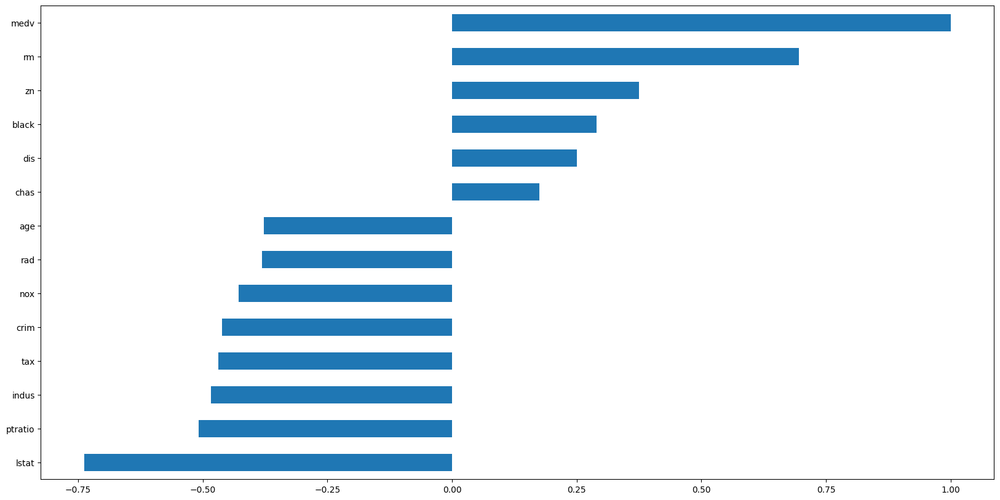

In [91]:
# Target Variable's correlation
df.corr()[target_var].sort_values().plot(kind="barh", figsize=(20,10))

<Axes: >

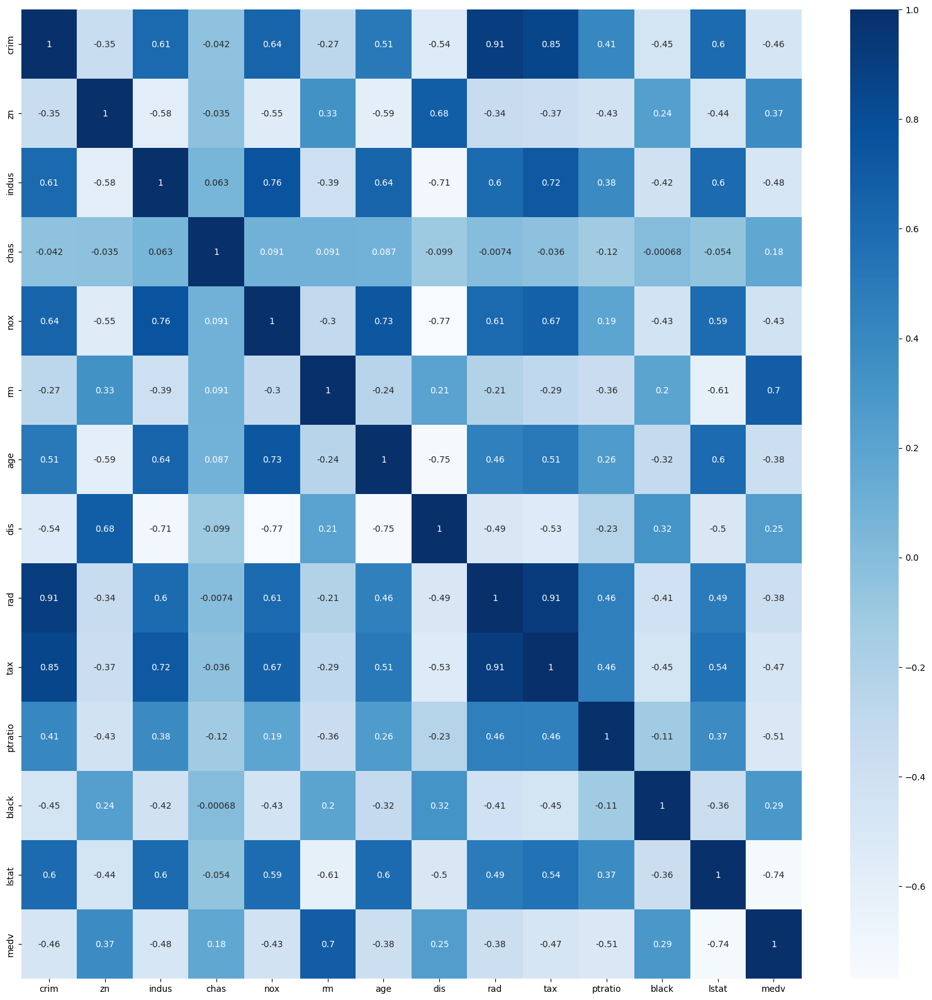

In [92]:
plt.figure(figsize=(20,20))
sns.heatmap(df.corr(), annot=True, cmap='Blues')

<Axes: >

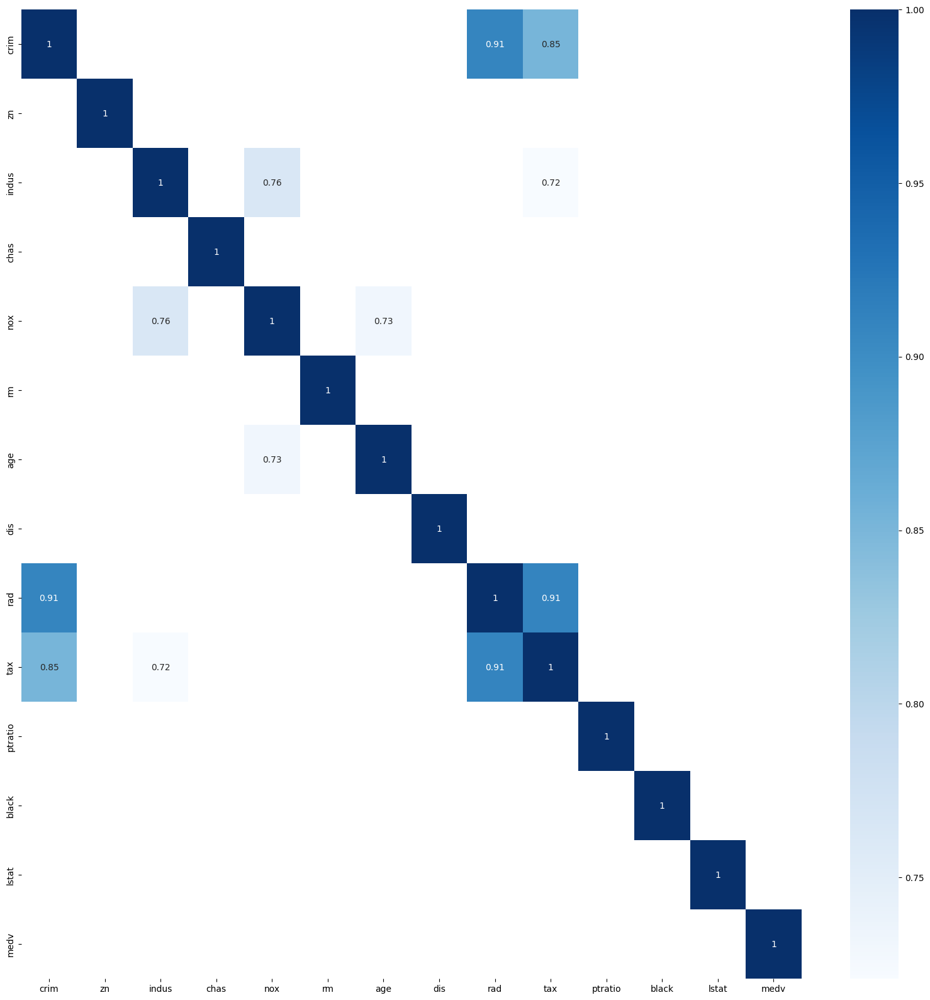

In [93]:
plt.figure(figsize=(20,20))
th = 0.7
sns.heatmap(df.corr()[df.corr() > th], annot=True, cmap='Blues')

<Axes: >

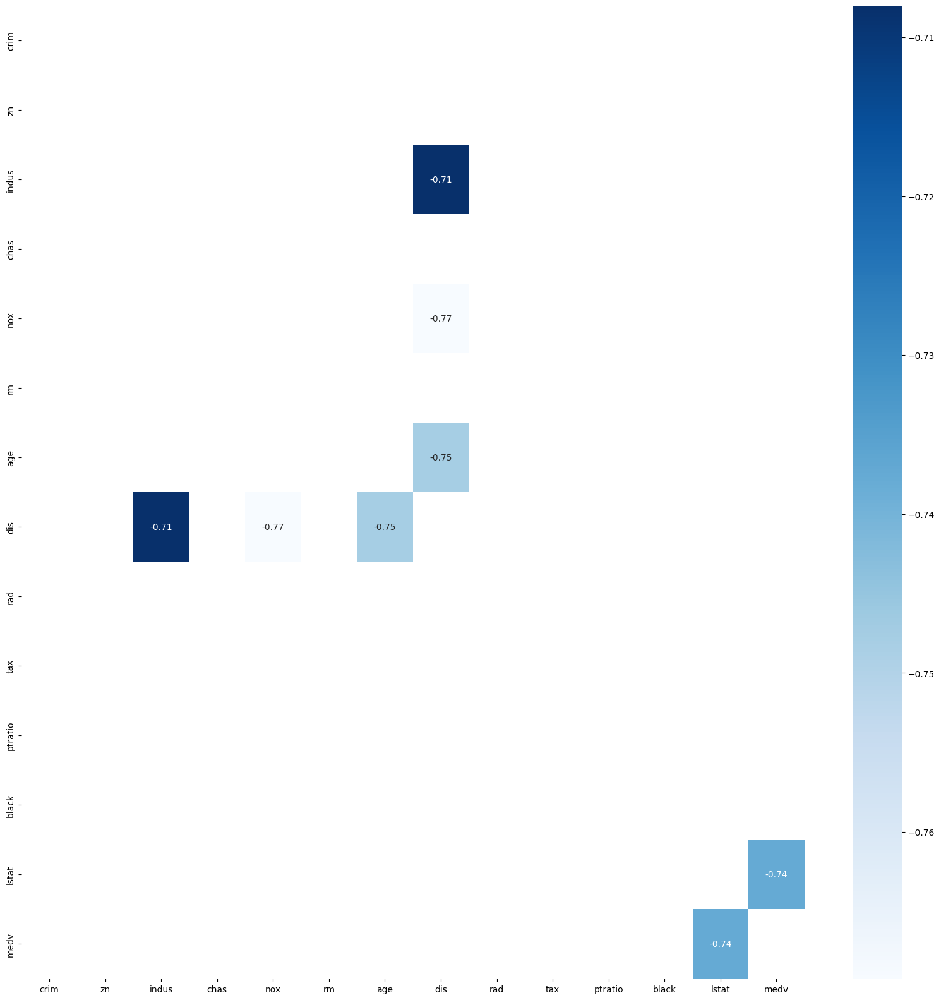

In [94]:
plt.figure(figsize=(20,20))
th = -0.7
sns.heatmap(df.corr()[df.corr() < th], annot=True, cmap='Blues')

In [95]:
target_var

'medv'

In [96]:
target_sorted_corrs = df.corr()[target_var].drop(target_var).sort_values(ascending=False)
target_sorted_corrs

rm         0.695360
zn         0.374340
black      0.289776
dis        0.249929
chas       0.175260
age       -0.376955
rad       -0.381626
nox       -0.427321
crim      -0.461110
tax       -0.468536
indus     -0.483725
ptratio   -0.507787
lstat     -0.737663
Name: medv, dtype: float64

### Variances

In [97]:
import numpy as np
variance_per_var = np.round(df.var().sort_values(ascending=False), 2)
variance_per_var

age        792.36
medv        84.59
rad         75.82
lstat       50.99
indus       47.06
ptratio      4.69
dis          4.43
tax          1.00
rm           0.49
zn           0.34
crim         0.19
chas         0.06
black        0.06
nox          0.01
dtype: float64

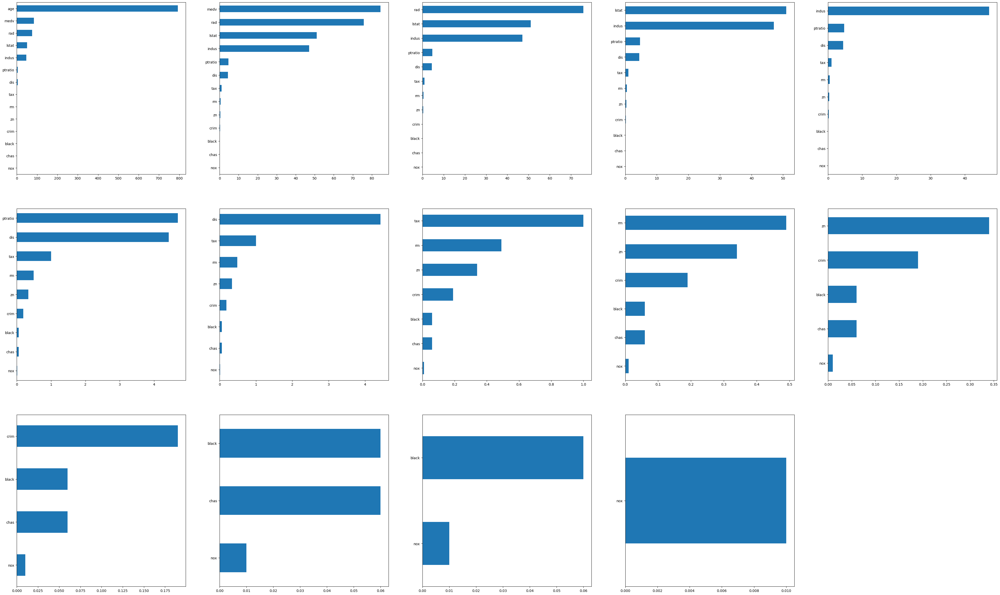

In [98]:
size = len(variance_per_var.index)
rs,cs = (size//5+1, 5) if size >= 5 else  (size//3+1, 3)

plt.figure(figsize=(cs*10, rs*10))
for i, col_name in enumerate(variance_per_var.index):
  plt.subplot(rs, cs, i+1)
  variance_per_var[col_name:].sort_values(ascending=True).plot.barh();

In [99]:
df.var().sort_values(ascending=False).round(2)

age        792.36
medv        84.59
rad         75.82
lstat       50.99
indus       47.06
ptratio      4.69
dis          4.43
tax          1.00
rm           0.49
zn           0.34
crim         0.19
chas         0.06
black        0.06
nox          0.01
dtype: float64

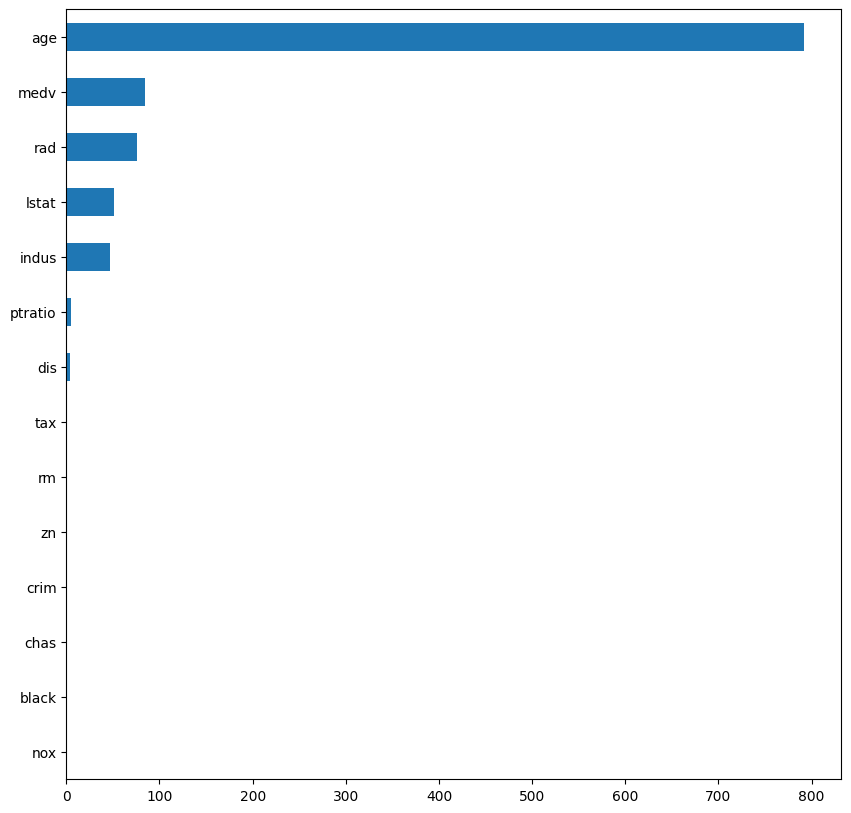

In [100]:
plt.figure(figsize=(10, 10))
df.var().sort_values(ascending=True).plot.barh();

### Covariance between target var

#### Way-1

In [101]:
def numerical_covariance(df, target_var):
    # Separate out numerical columns
    numerical_cols = df.select_dtypes(include=[int, float, "int8", bool]).columns

    # Create a copy of the DataFrame with only the numerical columns
    numerical_df = df[numerical_cols].copy()

    # If the target variable is categorical, encode it temporarily
    if df[target_var].dtype == 'object' or df[target_var].dtype == 'category':
        temp_encode = pd.get_dummies(df[target_var], prefix=target_var)
        numerical_df = pd.concat([numerical_df, temp_encode], axis=1)
        target_var = temp_encode.columns[0]

    # Calculate the covariance between each numerical column and the target variable
    covariances = numerical_df.cov()[target_var]

    # Return the result as a pandas Series
    return covariances

In [102]:
covariances = np.round(numerical_covariance(df, target_var),2)
covariances

crim       -1.85
zn          2.02
indus     -30.52
chas        0.41
nox        -0.46
rm          4.49
age       -97.59
dis         4.84
rad       -30.56
tax        -4.31
ptratio   -10.11
black       0.65
lstat     -48.45
medv       84.59
Name: medv, dtype: float64

<Axes: >

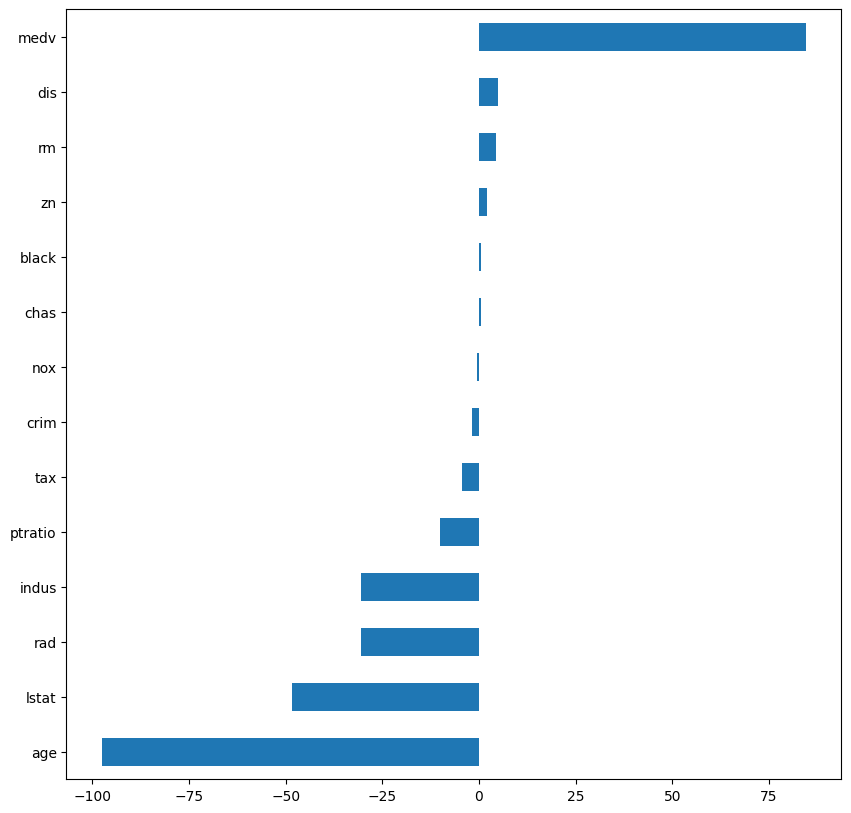

In [103]:
plt.figure(figsize=(10, 10))
covariances.sort_values(ascending=True).plot.barh()

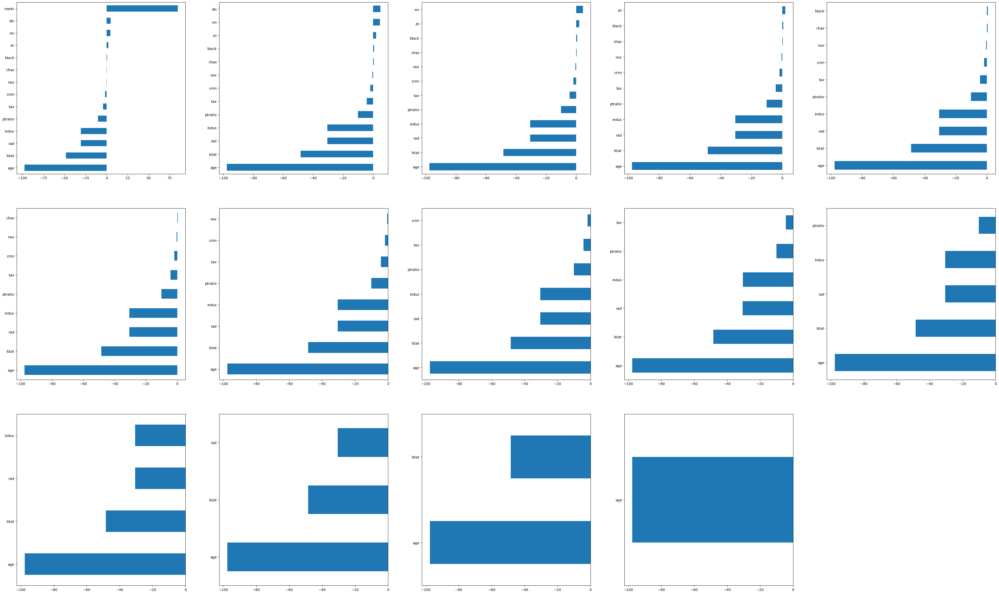

In [104]:
cov_target = numerical_covariance(df, target_var).sort_values(ascending=False)

size = len(cov_target.index)
rs,cs = (size//5+1, 5) if size >= 5 else  (size//3+1, 3)

plt.figure(figsize=(cs*10, rs*10))
for i, col_name in enumerate(cov_target.index):
  plt.subplot(rs, cs, i+1)
  cov_target[col_name:].sort_values(ascending=True).plot.barh()

#### Way-2
```python
# Calculate the covariance between the target and the feature
cov = {  col: [ np.cov(df[target_var].cat.codes, df[col])[0,1] ] for col in num_cols }
cov_s = pd.Series(np.squeeze(list(cov.values())), index=cov.keys())
cov_s
```

## Bivariate & Multivariate Analysis

In [105]:
num_cols

Index(['crim', 'zn', 'indus', 'chas', 'nox', 'rm', 'age', 'dis', 'rad', 'tax',
       'ptratio', 'black', 'lstat', 'medv'],
      dtype='object')

In [106]:
cat_cols

Index([], dtype='object')

In [107]:
len(df.columns) == (len(num_cols) + len(cat_cols))

True

<Axes: >

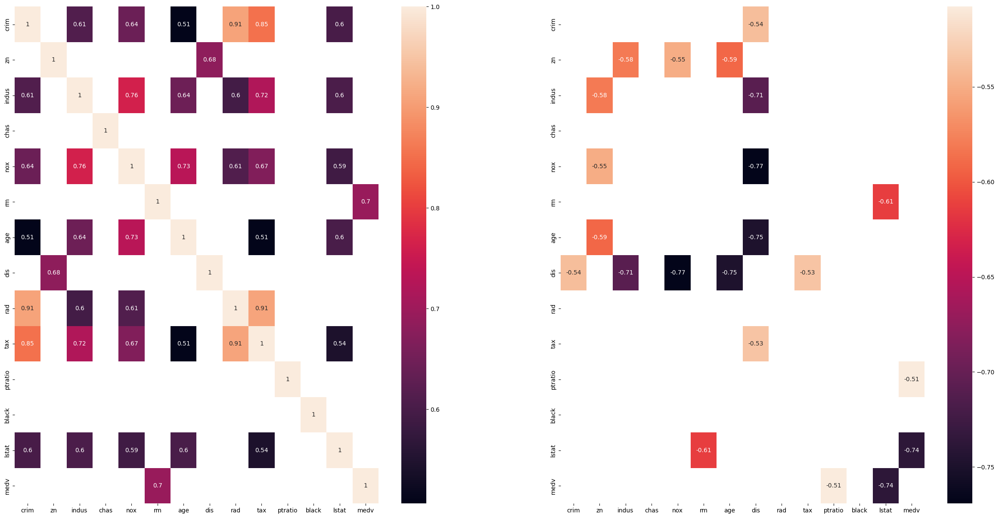

In [108]:
tmp_corrs = df.corr()

plt.figure(figsize=(30,15))

plt.subplot(1,2,1)
sns.heatmap(tmp_corrs[tmp_corrs>0.5], annot=True)

plt.subplot(1,2,2)
sns.heatmap(tmp_corrs[tmp_corrs < -0.5], annot=True)

<Axes: >

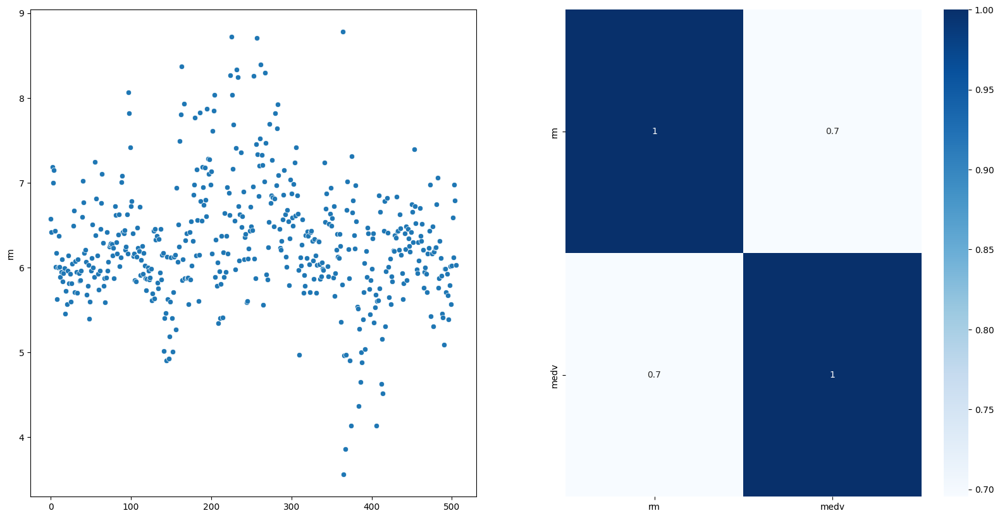

In [110]:
plt.figure(figsize=(20,10))

plt.subplot(1,2,1)
sns.scatterplot(df[target_sorted_corrs.index[0]]) # df[target_var]

plt.subplot(1,2,2)
tmp_corr=df[[target_sorted_corrs.index[0], target_var]].corr()
sns.heatmap(tmp_corr, annot=True,cmap='Blues')

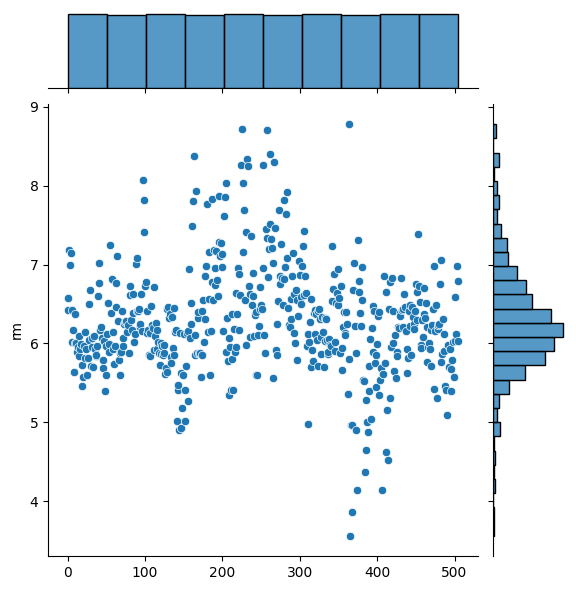

In [111]:
sns.JointGrid(df[target_sorted_corrs.index[0]]).plot(sns.scatterplot, sns.histplot); # , df[target_var]

<Axes: >

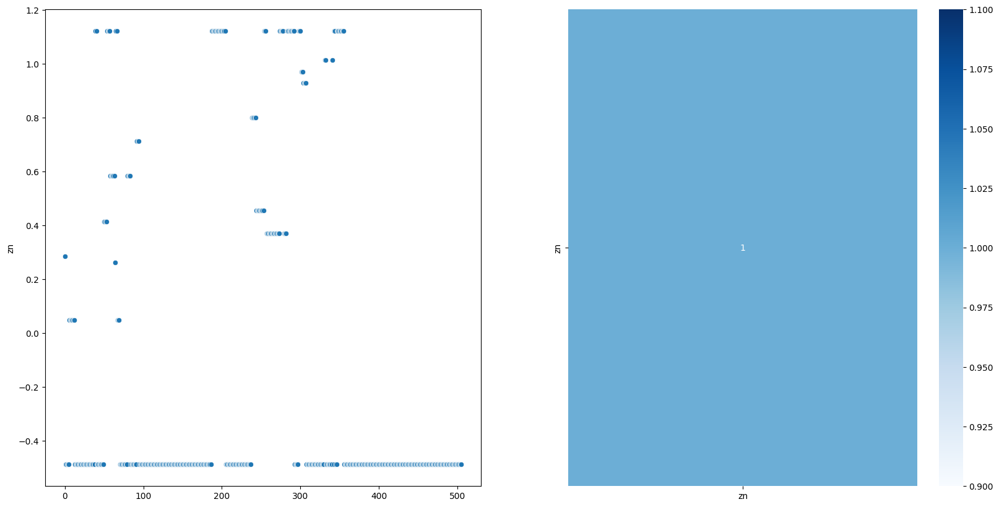

In [112]:
plt.figure(figsize=(20,10))

plt.subplot(1,2,1)
sns.scatterplot(df[target_sorted_corrs.index[1]]) # , df[target_var]

plt.subplot(1,2,2)
tmp_corr=df[[target_sorted_corrs.index[1]]].corr() # , target_var
sns.heatmap(tmp_corr, annot=True,cmap='Blues')

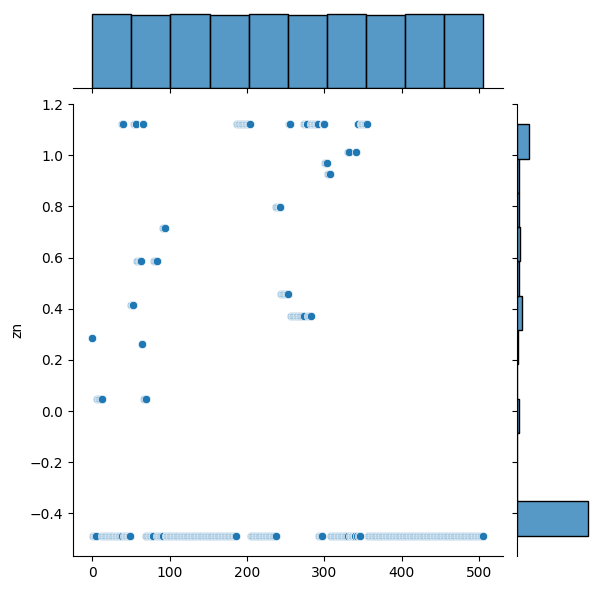

In [113]:
sns.JointGrid(df[target_sorted_corrs.index[1]]).plot(sns.scatterplot, sns.histplot); # , df[target_var]

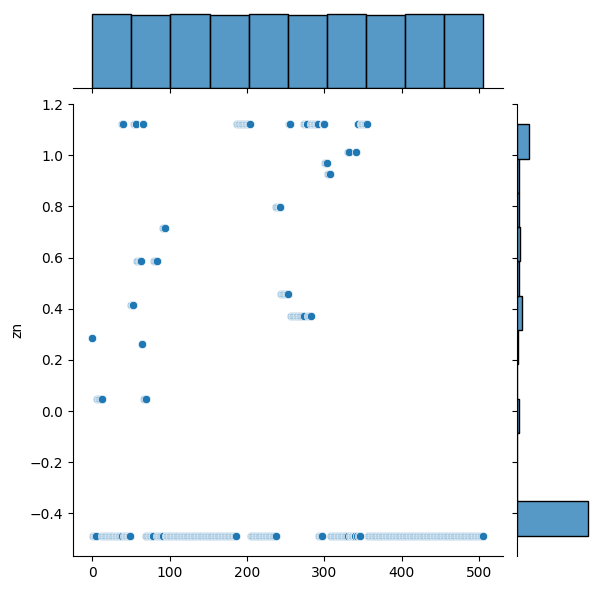

In [115]:
sns.JointGrid(df[target_sorted_corrs.index[1]]).plot(sns.scatterplot, sns.histplot); # , df[target_var]

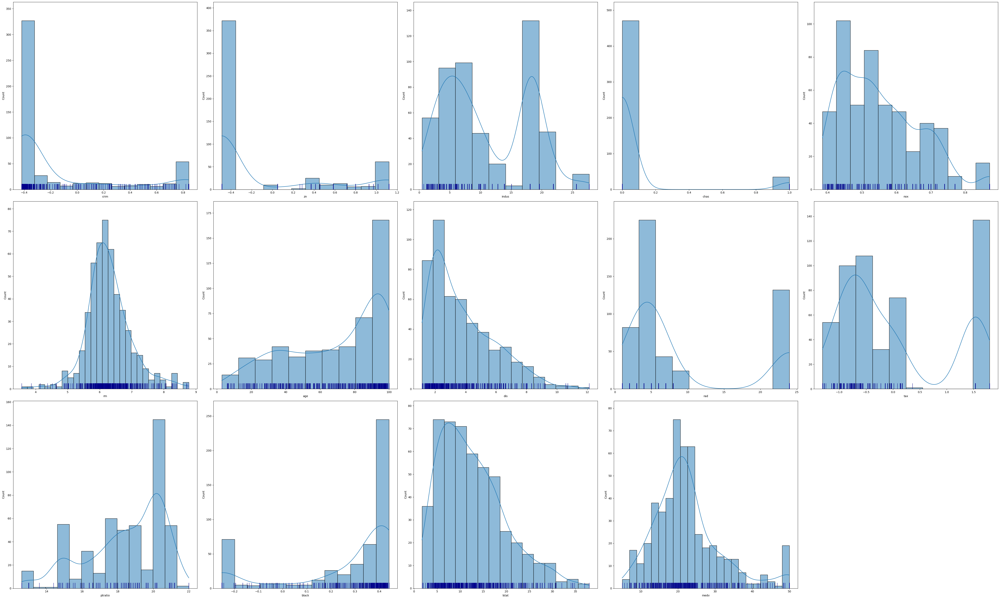

In [116]:
size = len(num_cols)
cs, rs = (5,size//5+1) if size>=5 else (3,size//3+1)

fig = plt.figure( figsize=(cs*10, rs*10))
for i, col in enumerate(num_cols):
    plt.subplot(rs,cs,i+1)
    sns.histplot(x=df[col], data=df, kde=True) #  hue=df[target_var],
    sns.rugplot(x=df[col], data=df,  height=.03, color='darkblue') # hue=df[target_var],
    
fig.tight_layout()  
plt.show()

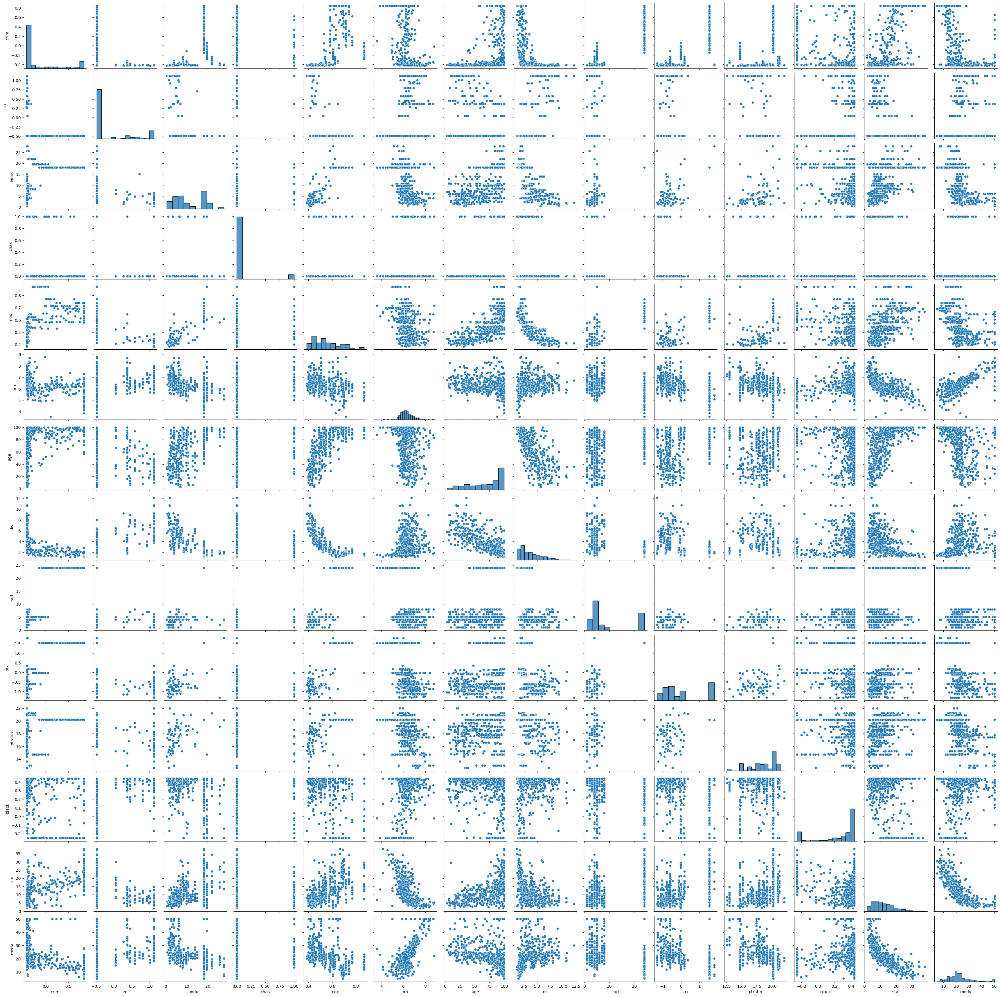

In [117]:
sns.pairplot(df[num_cols]);
# sns.pairplot(df[num_cols], hue=target_var);

<Figure size 2000x2000 with 0 Axes>

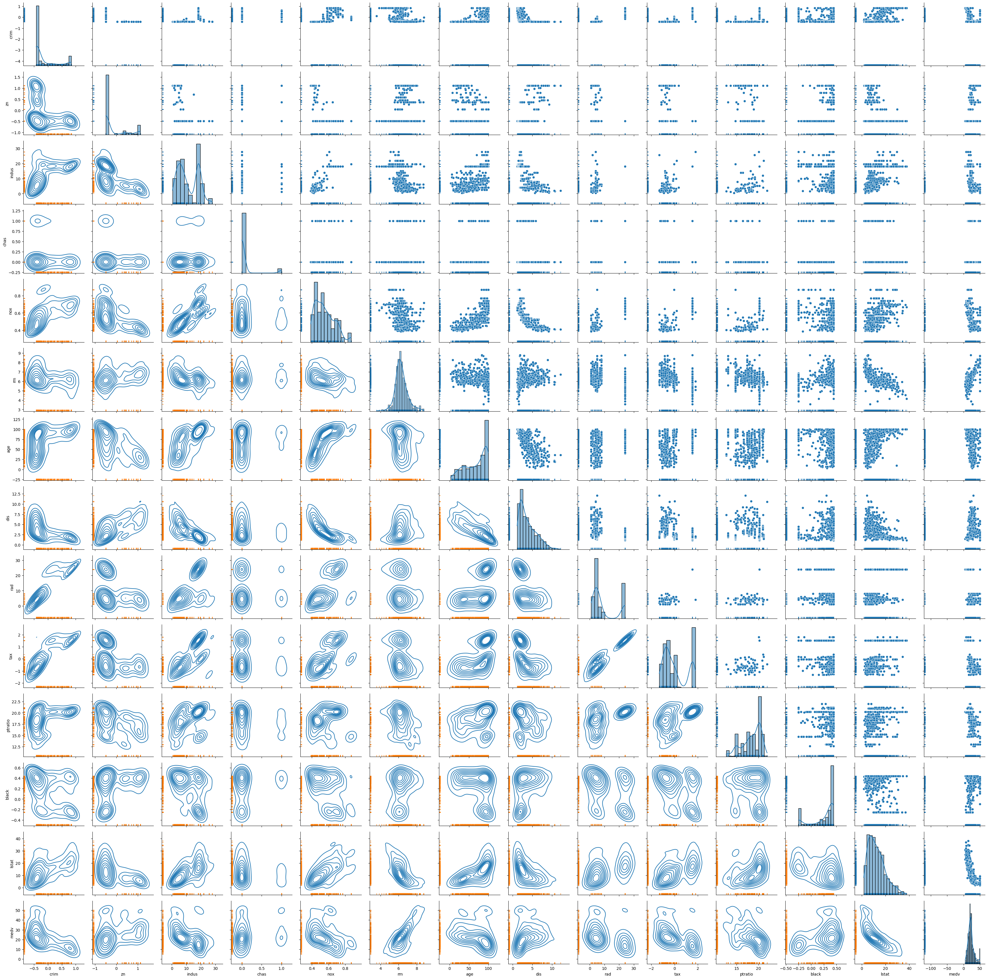

In [118]:
plt.figure(figsize=(20,20))

# Create a PairGrid instance
g = sns.PairGrid(df.select_dtypes(exclude=[bool]), diag_sharey=False) # hue=target_var
g.map_upper(sns.scatterplot)
g.map_diag(sns.histplot, kde=True)
g.map_lower(sns.kdeplot)
g.map(sns.rugplot);
g.add_legend();

<Figure size 2000x2000 with 0 Axes>

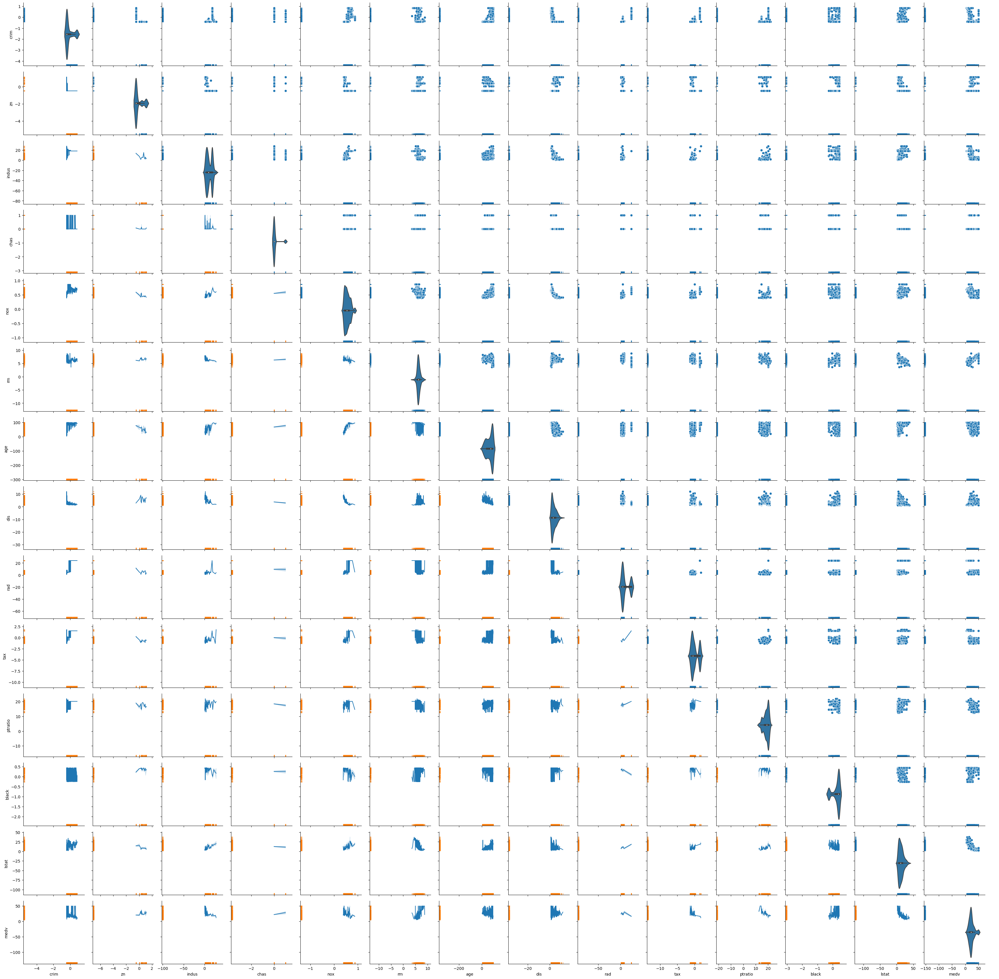

In [119]:
plt.figure(figsize=(20,20))

# Create a PairGrid instance
g = sns.PairGrid(df.select_dtypes(exclude=[bool]), diag_sharey=False) # , hue=target_var
g.map_upper(sns.scatterplot)
g.map_diag(sns.violinplot)
g.map_lower(sns.lineplot)
g.map(sns.rugplot)
g.add_legend();

<Figure size 2000x2000 with 0 Axes>

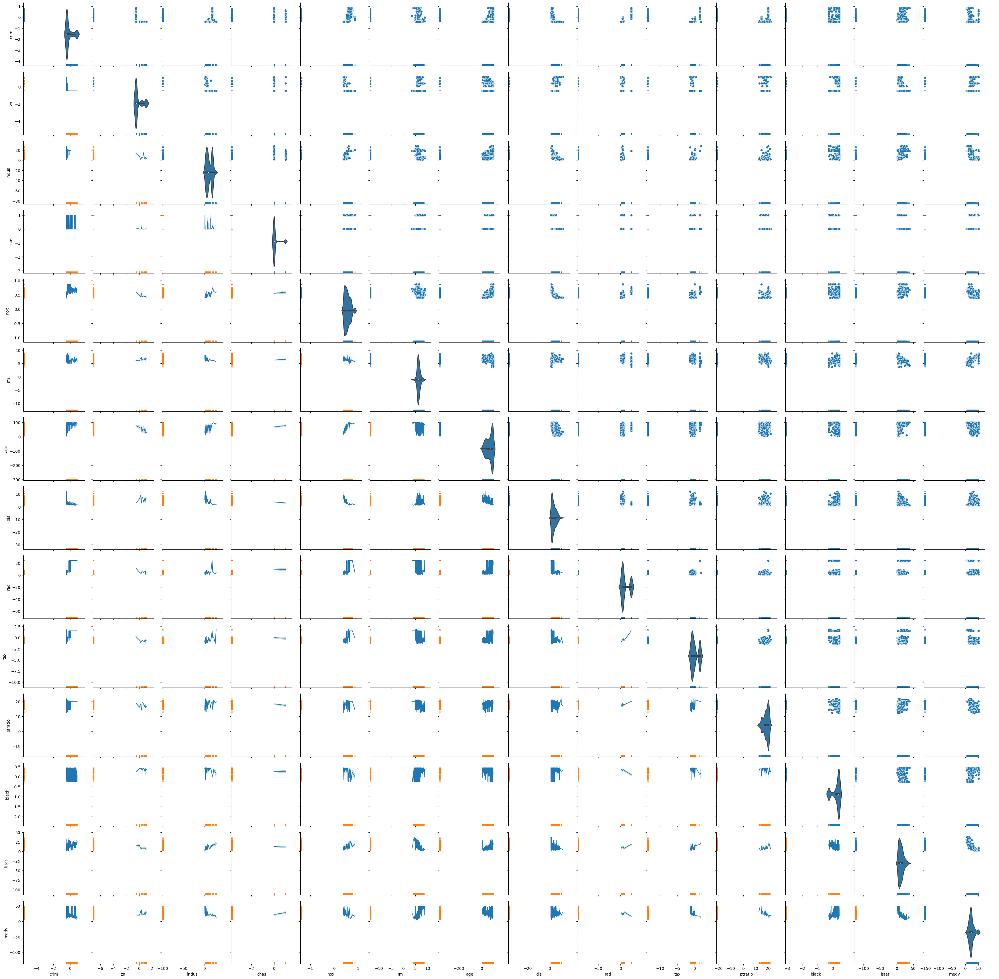

In [120]:
plt.figure(figsize=(20,20))

# Create a PairGrid instance
g = sns.PairGrid(df) # ,  hue=target_var
g.map_upper(sns.scatterplot)
g.map_diag(sns.violinplot)
g.map_lower(sns.lineplot)
g.map(sns.rugplot)
g.add_legend();

```python
row_size, col_size = len(num_cols), len(num_cols)
fig = plt.figure( figsize=(row_size*3, row_size*3))
for i, row in enumerate(num_cols):
    for j, col in enumerate(num_cols):
        ax=fig.add_subplot(row_size, col_size, (i*col_size)+j+1)
        sns.lineplot(data= df, x=row, y=col, ax=ax) # hue=target_var,
        
fig.tight_layout()  
plt.show()
```

```python
row_size = col_size = len(df.columns)
fig = plt.figure( figsize=(row_size*3, row_size*3))
for i, row in enumerate(num_cols):
    for j, col in enumerate(num_cols):
        ax=fig.add_subplot(row_size, col_size, (i*col_size)+j+1)
        sns.lineplot(data= df, x=row, y=col, ax=ax) #  hue=target_var,
        
fig.tight_layout()  
plt.show()
```

# (E) Model Selection (Classic ML models)

#### Utils

In [121]:
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import learning_curve

def plot_learning_curve(model, name, X, y, ylim=None, cv=None, n_jobs=1, train_sizes=np.linspace(.1, 1.0, 5), figsize=(20,20)):

    # checking the params
    if ylim is not None: plt.ylim(*ylim)
    
    # pre-declerations
    orange, blue = "#ff9124", "#2492ff"

    # Extracting the learning curve
    train_sizes, train_scores, test_scores = learning_curve(
        model, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    
    # Extracting the scores
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    # calculating params    
    tra_left_edge = train_scores_mean - train_scores_std
    tra_right_edge = train_scores_mean + train_scores_std

    test_left_edge = test_scores_mean - test_scores_std
    test_right_edge = test_scores_mean + test_scores_std

    # transparent plot for confidence value range
    plt.fill_between(train_sizes, tra_left_edge, tra_right_edge, alpha=0.1, color=orange)
    plt.fill_between(train_sizes, test_left_edge, test_right_edge, alpha=0.1, color=blue)
    
    # Plotting as point
    plt.plot(train_sizes, train_scores_mean, 'o-', color=orange, label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color=blue, label="Cross-validation score")
    
    # Configurating the plottings
    plt.title(f"{name} Learning Curve", fontsize=14)
    plt.xlabel('Training size (m)')
    plt.ylabel('Score')
    plt.grid(True)
    plt.legend(loc="best")

In [122]:
from sklearn.model_selection import cross_val_predict, cross_val_score
from sklearn.metrics import roc_auc_score
from sklearn.neighbors import KNeighborsClassifier

def get_learning_curve_stats(clfs, X_train, y_train, cv, model_size, rs, cs, figsize, ylim):

  plt.figure(figsize=figsize)
  # EXtracting the learning curve and validation metrics
  best_models_cross_val_preds, roc_auc_scores = {}, {}
  for i, (name, model) in enumerate(clfs.items()):

    # Training with best models again (the best params already saved inside) for visualizate the duration.
    plt.subplot(rs, cs, i+1)
    print(f"{i}.turn [{name}], plotting learning curve")
    plot_learning_curve(model, name, X_train, y_train, ylim, cv=cv, n_jobs=-1, figsize=figsize) 

    # validating the trained models
    #print(f"{i}.turn, cross_validation")
    #method = "decision_function" if name in ["loj_reg", "svc"] else "predict"
    #best_models_cross_val_preds[name]  = cross_val_predict(model, X_train, y_train, cv=5, method=method)

    # Displating the roc scores
    #print(f"{i}.turn, roc_auc_scores")
    #roc_auc_scores[name] = roc_auc_score(y_train, best_models_cross_val_preds[name])
    #print(f'{name:<20}: ',roc_auc_scores[name])

  return plt.gcf()#, best_models_cross_val_preds#, roc_auc_scores

```python
# Example Usage
model_size = len(us_models)
rs, cs = (model_size//2+1, 4 ) if model_size >= 4 else (model_size//2+1, 2)
lcs_params = {
    "cv" : ShuffleSplit(n_splits=100, test_size=0.2, random_state=42),
    "model_size": model_size,
    "rs":rs,
    "cs":cs,
    "figsize" : (40,20),
    "ylim" : (0.87, 1.01)
}

lc_plot, best_models_cross_val_preds, roc_auc_scores  = get_learning_curve_stats(us_models, figsize=(40,10), **lcs_params)
```

## Prepare The Data To Training

### Splitting the dataset
```python
# train, test split
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

# train, validation split
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.20)
```

In [123]:
target_var

'medv'

In [124]:
#X = df.drop(columns=target_var)
#y = df[target_var]

# ['Outlet_Establishment_Year', 'Item_Identifier', 'Outlet_Identifier']

X = df.drop(columns=['medv'])
y = df['medv']

#### Train-Test Split

In [125]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

## Util Functions
- Utils functions for model tuning

### Greedy Step tune

In [126]:
from sklearn.model_selection import GridSearchCV
from pprint import pprint

def greedy_search(model, params:dict, X_train, y_train, cv=10, n_jobs=-1, verbose=2, is_print=False):
  """It tunes params individually step by step . select best value on current step.
  It assumes the params sorted by importance on the model as descending. 
  The important param, second important param, etc.... 
  """
  
  best_params = {}
  for name, values in params.items():
    # Initial params
    best_params[name] = values

    if is_print: print("before:");pprint(best_params);
    
    # create GridSearch&Train 
    cv_model = GridSearchCV(model, best_params, cv=cv, n_jobs=n_jobs, verbose=verbose)
    cv_model.fit(X_train, y_train)

    # Update the param
    best_params[name] = [cv_model.best_params_[name]]
    
    if is_print: print("after:");pprint(best_params);print("-"*25, end="\n\n");

  return cv_model, cv_model.best_estimator_, best_params

### Model Tuner

In [127]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report


def gen_clf_metrics(y_test, y_pred, is_round, return_y_data=False):
  """
  Calculate and return a dictionary of common classification metrics.
  """

  if is_round: y_pred = np.round(y_pred).astype(np.int64)

  clf_metrics = {
            "accuracy":accuracy_score(y_test, y_pred),
            "precision" : precision_score(y_test, y_pred, average="micro"),
            "recall": recall_score(y_test, y_pred, average="micro"),
            "f1_score": f1_score(y_test, y_pred, average="micro"),
            "clf_report":classification_report(y_test, y_pred, output_dict=True)
  }

  if return_y_data:
    clf_metrics["y_pred"] = y_pred
    clf_metrics["y_test"] = y_test
            
  
  return clf_metrics

In [128]:
from sklearn.metrics import mean_squared_error, r2_score, explained_variance_score, mean_absolute_error, median_absolute_error

def gen_reg_metrics(y_test, y_pred, is_round, return_y_data=False):
  """
  Calculate and return a dictionary of common regression metrics.
  """

  if is_round: y_pred = np.round(y_pred).astype(np.int64)


  reg_metrics = {
      "MaxError": np.max(y_test - y_pred),
      "MeanAbsoluteError": median_absolute_error(y_test, y_pred),
      "MeanAbsolutePercentageError": np.mean(np.abs((y_test - y_pred) / y_test)) * 100,
      "MSE": mean_squared_error(y_test, y_pred),
      "RMSE": mean_squared_error(y_test, y_pred, squared=False),
      "MAE": mean_absolute_error(y_test, y_pred),
      "R2":r2_score(y_test, y_pred),
      "ExplainedVariance":explained_variance_score(y_test, y_pred)
  }

  if return_y_data:
    reg_metrics["y_pred"] = y_pred
    reg_metrics["y_test"] = y_test


  return reg_metrics

In [129]:
import pandas as pd
def tune_models(tuners, X_train, y_train, X_test, y_test, is_clf, cv=10, is_round=False, return_y_data=False):
  
  results, metric_summary = dict(), dict()
  for name, [model, params] in tuners.items():
    # Tuning
    cv_model, tuned_model, best_params = greedy_search(model, params, X_train, y_train, cv=cv)
    
    # predicting
    y_pred = tuned_model.predict(X_test)
    metric_kwargs = {"y_test":y_test, "y_pred":y_pred, "is_round":is_round, "return_y_data":return_y_data} 
    metric_results = gen_clf_metrics(**metric_kwargs) if is_clf else gen_reg_metrics(**metric_kwargs)

    # Generating results
    cur_results = {
        "tune_results": {
            "cv_model":cv_model,
            "tuned_model":tuned_model,
            "best_params":best_params,
        },
        "metric_results": metric_results
    }
    
    results[name] = cur_results
    metric_summary[name] = metric_results

  return results, pd.DataFrame(metric_summary).T


In [130]:
import pandas as pd
def tune_linear_cv_models(tuners, X_train, y_train, X_test, y_test, is_clf, is_round=False, return_y_data=False):
  
  results, metric_summary = dict(), dict()
  for name, [model, params] in tuners.items():
      # Tuning
      tuned_model = model(**params)
      tuned_model.fit(X_train, y_train)
      
      # predicting
      y_pred = tuned_model.predict(X_test)
      metric_kwargs = {"y_test":y_test, "y_pred":y_pred, "is_round":is_round, "return_y_data":return_y_data} 
      metric_results = gen_clf_metrics(**metric_kwargs) if is_clf else gen_reg_metrics(**metric_kwargs)

      # Generating results
      cur_results = {
          "tune_results": {
              "tuned_model":tuned_model,
              "best_params":tuned_model.get_params(True) ,#best_params_,
          },
          "metric_results": metric_results
      }
      
      results[name] = cur_results
      metric_summary[name] = metric_results

  return results, pd.DataFrame(metric_summary).T

## (1) Linear Models

### Hyperparams

In [131]:
lin_params = {
    'fit_intercept': [True, False],
    #'normalize': [True, False],
    'copy_X': [True, False],
}
from sklearn.linear_model import LinearRegression
linear_reg = [LinearRegression(), lin_params]

In [132]:
lasso_params = {
    "alpha": np.logspace(-4, 0, 100).flatten(),
    #'tol': [1e-3, 1e-4],
    #'eps': [1e-2, 1e-3, 1e-4],
    #'fit_intercept': [True, False],
    #'normalize': [True, False],
    #'max_iter': [1000, 5000, 10000],
    'fit_intercept': [True, False],
    #'normalize': [True, False],
    'max_iter': [1000, 5000, 10000]
}

from sklearn.linear_model import Lasso, LassoCV
l1_reg = [Lasso(), lasso_params] 

In [133]:
ridge_params = {
    "alpha": np.logspace(-4, 0, 100), #p.arange(0.00, 1.0, 0.01), #(10**np.linspace(10,-2,100))*0.5,
    #'normalize': [True, False],
    #'tol': [1e-4, 1e-3, 1e-2],
    'fit_intercept': [True, False],
    #'normalize': [True, False]
}

from sklearn.linear_model import Ridge, RidgeCV 
l2_reg = [Ridge(), ridge_params]

In [134]:
ElasticNet_params = {
    "alpha": np.logspace(-4, 0, 100),
    'l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9],
    'tol': [1e-4, 1e-3, 1e-2],
    'selection': ['cyclic', 'random'],    
    #'normalize': [True, False],
    'max_iter': [1000, 5000, 10000], 
}
from sklearn.linear_model import ElasticNet, ElasticNetCV 
enet_reg = [ElasticNet(), ElasticNet_params]

In [135]:
linear_cv_tuners = {
    "l1_reg":l1_reg,
    
    "l2_reg":l2_reg,
    "enet_reg":enet_reg
}
linear_tuners = {
    "lin_reg":linear_reg,
    #**linear_cv_tuners
}

### Tuning Demostration

In [136]:
lin_results, lin_metric_summary = tune_models(linear_cv_tuners, X_train, y_train, X_test, y_test, cv=10, is_clf=False, is_round=True)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 3 candidates, totalling 30 fits
Fitting 10 folds for each of 100 candidates, totalling 1000 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 100 candidates, totalling 1000 fits
Fitting 10 folds for each of 5 candidates, totalling 50 fits
Fitting 10 folds for each of 3 candidates, totalling 30 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 3 candidates, totalling 30 fits


In [137]:
#lin_results, lin_metric_summary = tune_linear_cv_models(linear_cv_tuners, X_train, y_train, X_test, y_test, is_clf=False, is_round=True)

In [138]:
list(lin_results.keys())

['l1_reg', 'l2_reg', 'enet_reg']

In [139]:
lin_metric_summary

,MaxError,MeanAbsoluteError,MeanAbsolutePercentageError,MSE,RMSE,MAE,R2,ExplainedVariance
l1_reg,12.3,2.7,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306
l2_reg,12.3,2.7,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306
enet_reg,12.3,2.7,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306


In [140]:
from pprint import pprint
pprint(lin_results)

{'enet_reg': {'metric_results': {'ExplainedVariance': 0.7753056987416964,
                                 'MAE': 3.272549019607844,
                                 'MSE': 19.551372549019604,
                                 'MaxError': 12.299999999999997,
                                 'MeanAbsoluteError': 2.6999999999999993,
                                 'MeanAbsolutePercentageError': 15.484242418291045,
                                 'R2': 0.7738325203811762,
                                 'RMSE': 4.421693402874017},
              'tune_results': {'best_params': {'alpha': [0.0001],
                                               'l1_ratio': [0.9],
                                               'max_iter': [1000],
                                               'selection': ['cyclic'],
                                               'tol': [0.0001]},
                               'cv_model': GridSearchCV(cv=10, estimator=ElasticNet(), n_jobs=-1,
             param_grid={'alph

In [141]:
#tuned_model
lin_results.keys()

dict_keys(['l1_reg', 'l2_reg', 'enet_reg'])

In [142]:
lin_results["l1_reg"].keys()

dict_keys(['tune_results', 'metric_results'])

In [143]:
lin_results["l1_reg"]["tune_results"].keys()

dict_keys(['cv_model', 'tuned_model', 'best_params'])

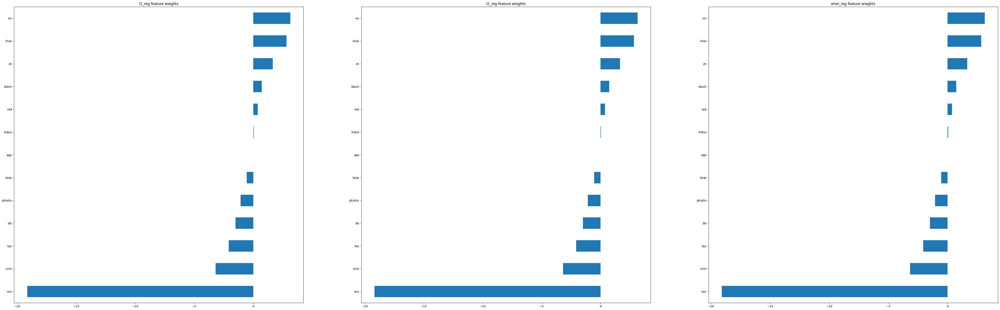

In [144]:
size = len(lin_results.keys())
rs, cs = (size//5+1, 5) if size>=5 else (size//3+1, 3)

plt.figure(figsize=(cs*20, rs*20))
lin_models = {}
for i, model_name in enumerate(lin_results.keys()):

  cur_model = lin_results[model_name]["tune_results"]["tuned_model"]
  lin_models[model_name] = cur_model
  
  plt.subplot(rs,cs,i+1)
  pd.Series(cur_model.coef_, X_train.columns).sort_values().plot(kind="barh")
  plt.title(f"{model_name} feature wieghts")

0.turn [l1_reg], plotting learning curve
1.turn [l2_reg], plotting learning curve
2.turn [enet_reg], plotting learning curve


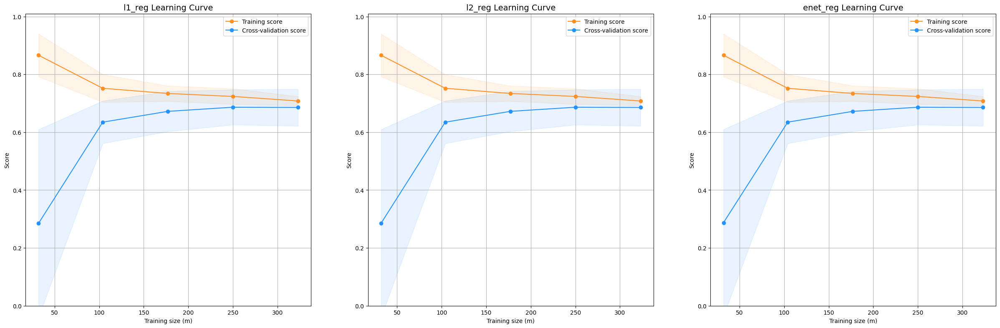

In [145]:
# Example Usage
model_size = len(lin_models)
rs, cs = (model_size//3+1, 3 ) if model_size >= 3 else (model_size//2+1, 2)
lcs_params = {
    "cv" : ShuffleSplit(n_splits=10, test_size=0.2, random_state=42),
    "model_size": model_size,
    "rs":rs,
    "cs":cs,
    "figsize" : (cs*10,rs*10),
    "ylim" : (0.0, 1.01)
}

lc_plot  = get_learning_curve_stats(lin_models, X_train, y_train,  **lcs_params)

In [146]:
lin_reg_results, lin_reg_metric_summary = tune_models(linear_tuners, X_train, y_train,X_test, y_test, is_clf=False, is_round=True)

Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits


In [147]:
list(lin_reg_results.keys())

['lin_reg']

In [148]:
lin_reg_metric_summary

,ExplainedVariance,MAE,MSE,MaxError,MeanAbsoluteError,MeanAbsolutePercentageError,R2,RMSE
lin_reg,0.775306,3.272549,19.551373,12.3,2.7,15.484242,0.773833,4.421693


In [149]:
from pprint import pprint
pprint(lin_reg_results)

{'lin_reg': {'metric_results': {'ExplainedVariance': 0.7753056987416964,
                                'MAE': 3.272549019607844,
                                'MSE': 19.551372549019604,
                                'MaxError': 12.299999999999997,
                                'MeanAbsoluteError': 2.6999999999999993,
                                'MeanAbsolutePercentageError': 15.484242418291045,
                                'R2': 0.7738325203811762,
                                'RMSE': 4.421693402874017},
             'tune_results': {'best_params': {'copy_X': [True],
                                              'fit_intercept': [True]},
                              'cv_model': GridSearchCV(cv=10, estimator=LinearRegression(), n_jobs=-1,
             param_grid={'copy_X': [True], 'fit_intercept': [True]}, verbose=2),
                              'tuned_model': LinearRegression()}}}


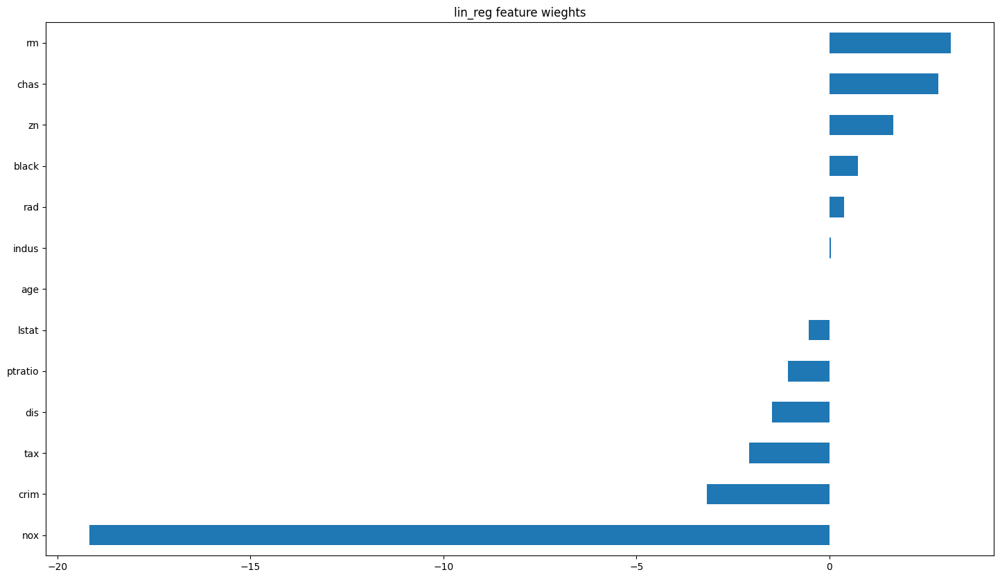

In [150]:
size = len(lin_reg_results.keys())
rs, cs = (size//5+1, 5) if size>=5 else (size//3+1, 3)

plt.figure(figsize=(cs*20, rs*10))
lin_reg_models = dict()
for i, model_name in enumerate(lin_reg_results.keys()):

  cur_model = lin_reg_results[model_name]["tune_results"]["tuned_model"]
  lin_reg_models[model_name] = cur_model

  plt.subplot(rs,cs,i+1)
  pd.Series(cur_model.coef_, X_train.columns).sort_values().plot(kind="barh")
  plt.title(f"{model_name} feature wieghts")

0.turn [lin_reg], plotting learning curve


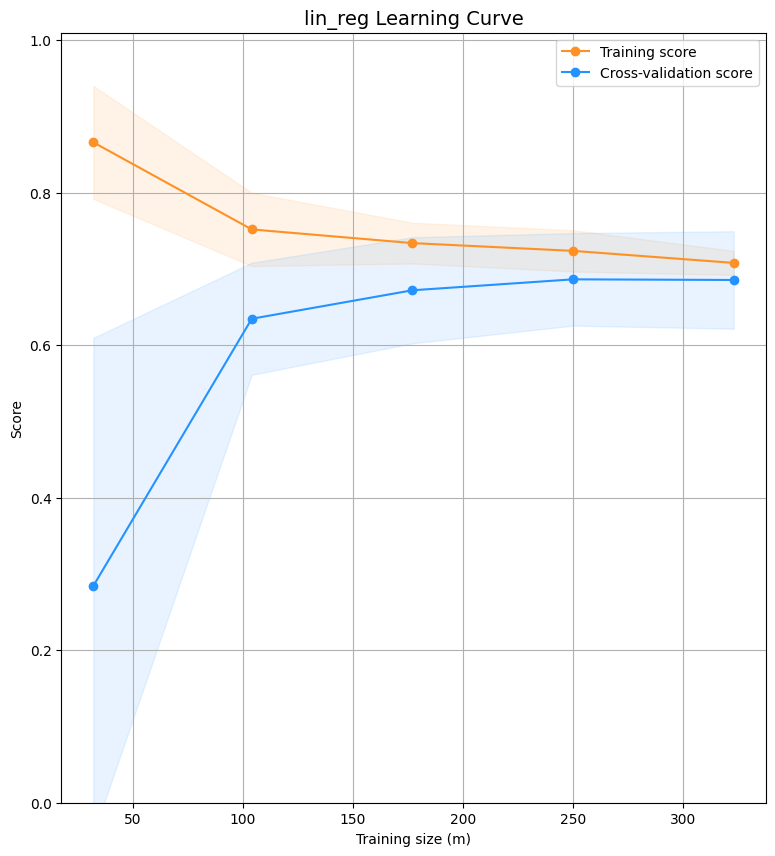

In [151]:
# Example Usage
model_size = len(lin_reg_models)
rs, cs = (model_size//2+1, 4 ) if model_size >= 4 else (model_size//2+1, 2)
lcs_params = {
    "cv" : ShuffleSplit(n_splits=10, test_size=0.2, random_state=42),
    "model_size": model_size,
    "rs":rs,
    "cs":cs,
    "figsize" : (cs*10,rs*10),
    "ylim" : (0.0, 1.01)
}

lc_plot  = get_learning_curve_stats(lin_reg_models, X_train, y_train,  **lcs_params)

## (2) Non-Linear Models 

##### Hyperparams

In [152]:
knn_params = {
    "n_neighbors": np.arange(1, 31, 2),
    "weights": ["uniform", "distance"],
    "algorithm": ["auto", "ball_tree", "kd_tree", "brute"],
    "leaf_size": np.arange(20, 61, 10),
    "p": [1, 2],
}
from sklearn.neighbors import KNeighborsRegressor
knn_reg = [KNeighborsRegressor(), knn_params]

In [153]:
svr_params = {
    "C": np.logspace(-3, 3, 7),
    "kernel": ["linear","rbf"],#["linear", "poly", "rbf", "sigmoid"],
    #"degree": [2, 3, 4],
    "gamma": ["scale", "auto"] + list(np.logspace(-3, 3, 7)),
    "epsilon":[0.01, 0.1, 1, 10, 100],
    #"coef0": np.linspace(-1, 1, 21),
    #"shrinking": [True, False],
    #"tol": [1e-4, 1e-3, 1e-2],
    #"max_iter": [-1, 500, 1000, 2000]
}
from sklearn.svm import SVR
svr_reg = [SVR(), svr_params]

In [154]:
dt_params = {
    "criterion": ["mse", "friedman_mse", "mae"],
    "splitter": ["best", "random"],
    "max_depth": [None, 5, 10, 15, 20],
    "min_samples_split": [2, 5, 10],
    "min_samples_leaf": [1, 2, 5],
    #"min_weight_fraction_leaf": [0.0, 0.1, 0.2],
    #"max_features": ["auto", "sqrt", "log2", None],
    #"random_state": [0, 42, 123],
    #"presort": [True, False]
}
from sklearn.tree import DecisionTreeRegressor
dt_reg = [DecisionTreeRegressor(), dt_params]

In [155]:
non_lin_reg_tuners = {
    "knn_reg":knn_reg,
    "svr_reg":svr_reg,
    "dt_params":dt_reg
}

##### Tuning Demostration

In [156]:
non_lin_results, non_lin_metric_summary = tune_models(non_lin_reg_tuners, X_train, y_train, X_test, y_test, is_clf=False, is_round=True)

Fitting 10 folds for each of 15 candidates, totalling 150 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 4 candidates, totalling 40 fits
Fitting 10 folds for each of 5 candidates, totalling 50 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 7 candidates, totalling 70 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 9 candidates, totalling 90 fits
Fitting 10 folds for each of 5 candidates, totalling 50 fits
Fitting 10 folds for each of 3 candidates, totalling 30 fits
Fitting 10 folds for each of 2 candidates, totalling 20 fits
Fitting 10 folds for each of 5 candidates, totalling 50 fits
Fitting 10 folds for each of 3 candidates, totalling 30 fits
Fitting 10 folds for each of 3 candidates, totalling 30 fits


In [157]:
list(non_lin_results.keys())

['knn_reg', 'svr_reg', 'dt_params']

In [158]:
non_lin_metric_summary

,MaxError,MeanAbsoluteError,MeanAbsolutePercentageError,MSE,RMSE,MAE,R2,ExplainedVariance
knn_reg,24.0,2.10,14.729846,30.463137,5.519342,3.464706,0.647607,0.662414
svr_reg,16.5,1.65,12.464594,13.441569,3.666274,2.550980,0.844510,0.851877
dt_params,13.5,2.20,13.343018,12.810196,3.579133,2.694118,0.851813,0.852981


In [159]:
from pprint import pprint
pprint(non_lin_results)

{'dt_params': {'metric_results': {'ExplainedVariance': 0.8529806778097017,
                                  'MAE': 2.6941176470588237,
                                  'MSE': 12.810196078431371,
                                  'MaxError': 13.5,
                                  'MeanAbsoluteError': 2.1999999999999993,
                                  'MeanAbsolutePercentageError': 13.343017711626043,
                                  'R2': 0.8518134850523809,
                                  'RMSE': 3.57913342562573},
               'tune_results': {'best_params': {'criterion': ['friedman_mse'],
                                                'max_depth': [5],
                                                'min_samples_leaf': [1],
                                                'min_samples_split': [10],
                                                'splitter': ['best']},
                                'cv_model': GridSearchCV(cv=10, estimator=DecisionTreeRegressor(), n_jobs=

In [160]:
non_lin_reg_models = {model_name:results["tune_results"]["tuned_model"] for model_name, results in non_lin_results.items() }

0.turn [knn_reg], plotting learning curve
1.turn [svr_reg], plotting learning curve
2.turn [dt_params], plotting learning curve


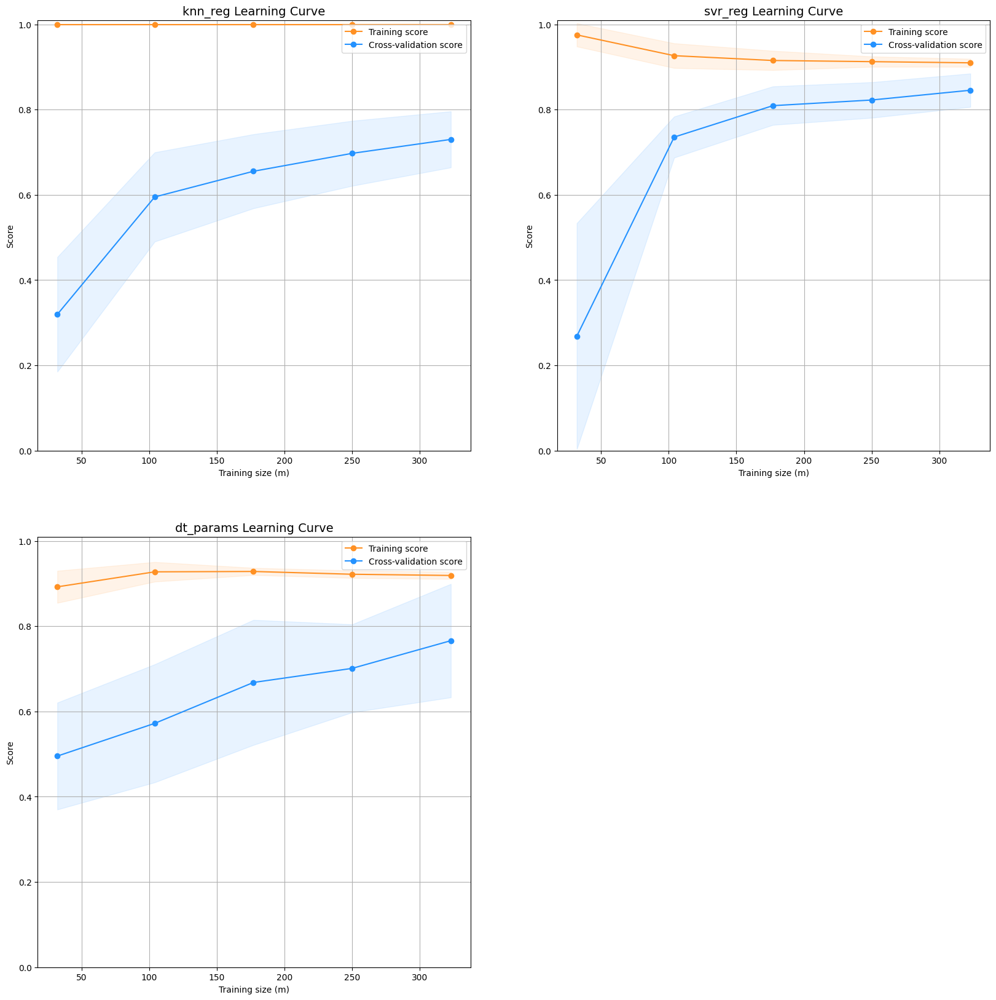

In [161]:
# Example Usage
model_size = len(non_lin_reg_models)
rs, cs = (model_size//4+1, 4 ) if model_size >= 4 else (model_size//2+1, 2)
lcs_params = {
    "cv" : ShuffleSplit(n_splits=10, test_size=0.2, random_state=42),
    "model_size": model_size,
    "rs":rs,
    "cs":cs,
    "figsize" : (cs*10,rs*10),
    "ylim" : (0.0, 1.01)
}

lc_plot  = get_learning_curve_stats(non_lin_reg_models, X_train, y_train,  **lcs_params)

## (3) Ensemble Models

### Hyperparams

In [176]:
bag_params = {
    "base_estimator": [None, DecisionTreeRegressor(), SVR()],
    "n_estimators": [10, 20, 30, 40, 50],
    "max_samples": [1.0, 0.8, 0.5, 0.3],
    "max_features": [1.0, 0.8, 0.5, 0.3],
    "bootstrap": [True, False],
    "bootstrap_features": [True, False],
    "oob_score": [True, False],
    "warm_start": [True, False],
    "random_state": [0, 42, 123]
}
from sklearn.ensemble import BaggingRegressor
bag_reg = [BaggingRegressor(), bag_params]

In [177]:
rf_params = {
    "n_estimators": [10, 20, 30, 40, 50],
    #"criterion": ["mse", "mae"],
    "max_depth": [None, 5, 10, 15, 20],
    "min_samples_split": [2, 5, 10],
    "min_samples_leaf": [1, 2, 5],
    "min_weight_fraction_leaf": [0.0, 0.1, 0.2],
    "max_features": ["auto", "sqrt", "log2", None],
    "max_leaf_nodes": [None, 5, 10, 20],
    "bootstrap": [True, False],
    "oob_score": [True, False],
    "warm_start": [True, False],
    "random_state": [0, 42, 123]
}
from sklearn.ensemble import RandomForestRegressor
rf_reg = [RandomForestRegressor(), rf_params]

In [178]:
gbr_params = {
    "loss": ["ls", "lad", "huber", "quantile"],
    "learning_rate": [0.1, 0.05, 0.01],
    "n_estimators": [100, 200, 300, 400, 500],
    "criterion": ["friedman_mse", "mse", "mae"],
    "max_depth": [3, 4, 5, 6, 7],
    "min_samples_split": [2, 5, 10],
    "min_samples_leaf": [1, 2, 5],
    "min_weight_fraction_leaf": [0.0, 0.1, 0.2],
    "subsample": [1.0, 0.8, 0.5],
    "max_features": ["auto", "sqrt", "log2", None],
    "alpha": [0.9, 0.8, 0.7],
    "warm_start": [True, False],
    "random_state": [0, 42, 123]
}
from sklearn.ensemble import GradientBoostingRegressor
gbr = [GradientBoostingRegressor(), gbr_params]

In [179]:
#!pip install xgboost
xgbr_params = {
    "learning_rate": [0.1, 0.05, 0.01, 0.005],
    "n_estimators": [100, 200, 300, 400, 500],
    "max_depth": [3, 4, 5, 6, 7],
    "min_child_weight": [1, 2, 5, 10],
    "gamma": [0.0, 0.1, 0.2, 0.3],
    "subsample": [1.0, 0.8, 0.5],
    "colsample_bytree": [1.0, 0.8, 0.5],
    "reg_alpha": [0.0, 0.1, 0.5, 1.0],
    "reg_lambda": [0.0, 0.1, 0.5, 1.0],
    "scale_pos_weight": [1, 2, 5],
    "objective": ["reg:squarederror"],
    "booster": ["gbtree", "gblinear", "dart"],
    "random_state": [0, 42, 123]
}
from xgboost import XGBRegressor
xgbr = [XGBRegressor(), xgbr_params]

In [180]:
#!pip install lightgbm ##conda install -c conda-forge lightgbm
lgbm_params = {
    "boosting_type": ["gbdt", "dart", "goss"],
    "num_leaves": [31, 50, 100],
    "max_depth": [-1, 3, 4, 5, 6, 7],
    "learning_rate": [0.1, 0.05, 0.01, 0.005],
    "n_estimators": [100, 200, 300, 400, 500],
    "min_child_weight": [1, 2, 5, 10],
    "subsample_for_bin": [200000, 500000, 1000000],
    "min_split_gain": [0.0, 0.1, 0.2, 0.3],
    "reg_alpha": [0.0, 0.1, 0.5, 1.0],
    "reg_lambda": [0.0, 0.1, 0.5, 1.0],
    "colsample_bytree": [1.0, 0.8, 0.5],
    "subsample": [1.0, 0.8, 0.5],
    "is_unbalance": [True, False],
    "objective": ["regression"],
    "random_state": [0, 42, 123]
}
from lightgbm import LGBMRegressor
lgbm_reg = [LGBMRegressor(), lgbm_params]

In [181]:
!pip install catboost
catboost_params = {
    "learning_rate": [0.1, 0.05, 0.01, 0.005],
    "depth": [3, 4, 5, 6, 7],
    "l2_leaf_reg": [1, 2, 5, 10, 20],
    "iterations": [100, 200, 300, 400, 500],
    "border_count": [32, 64, 128, 256, 512],
    "boosting_type": ["Ordered", "Plain", "Poisson"],
    "random_strength": [1, 2, 5, 10],
    "one_hot_max_size": [2, 5, 10, 20, 50],
    "rsm": [0.5, 0.7, 0.9],
    "early_stopping_rounds": [5, 10, 20, 50],
    "task_type": ["CPU", "GPU"],
    "loss_function": ["RMSE"],
    "eval_metric": ["RMSE"],
    "random_seed": [0, 42, 123]
}
from catboost import CatBoostRegressor
catboost_reg = [CatBoostRegressor(), catboost_params]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [182]:
ensemble_tuners = {
    "bag_reg":bag_reg,
    "rf_reg":rf_reg,
    "gbr":gbr,
    "xgbr":xgbr,
    "lgbm_reg":lgbm_reg,
    "catboost_reg":catboost_reg
}

### Tuning Demostration

In [183]:
ensemble_results, ensemble_metric_summary = tune_models(ensemble_tuners,X_train, y_train, X_test, y_test, is_clf=False, is_round=True)

Streaming output truncated to the last 5000 lines.
9:	learn: 6.8512164	total: 7.97ms	remaining: 391ms
10:	learn: 6.6674446	total: 8.68ms	remaining: 386ms
11:	learn: 6.4947697	total: 9.37ms	remaining: 381ms
12:	learn: 6.2980642	total: 10.1ms	remaining: 378ms
13:	learn: 6.1386591	total: 10.8ms	remaining: 373ms
14:	learn: 5.9804527	total: 11.4ms	remaining: 370ms
15:	learn: 5.8209951	total: 12.2ms	remaining: 368ms
16:	learn: 5.6852351	total: 12.8ms	remaining: 365ms
17:	learn: 5.5533960	total: 13.6ms	remaining: 363ms
18:	learn: 5.4014535	total: 14.3ms	remaining: 362ms
19:	learn: 5.2823091	total: 15.1ms	remaining: 361ms
20:	learn: 5.1748793	total: 15.8ms	remaining: 360ms
21:	learn: 5.0378677	total: 16.4ms	remaining: 357ms
22:	learn: 4.9413149	total: 17.1ms	remaining: 355ms
23:	learn: 4.8305272	total: 17.9ms	remaining: 355ms
24:	learn: 4.7378950	total: 18.6ms	remaining: 353ms
25:	learn: 4.6345933	total: 19.3ms	remaining: 351ms
26:	learn: 4.5319046	total: 20ms	remaining: 350ms
27:	learn: 4.425

In [184]:
list(ensemble_results)

['bag_reg', 'rf_reg', 'gbr', 'xgbr', 'lgbm_reg', 'catboost_reg']

In [185]:
ensemble_metric_summary

,MaxError,MeanAbsoluteError,MeanAbsolutePercentageError,MSE,RMSE,MAE,R2,ExplainedVariance
bag_reg,11.5,1.50,10.273731,8.372941,2.893603,2.135294,0.903143,0.906935
rf_reg,10.5,1.50,10.086696,8.096471,2.845430,2.094118,0.906341,0.908946
gbr,10.0,1.50,10.155048,9.614118,3.100664,2.141176,0.888785,0.894613
xgbr,10.5,1.35,9.260301,7.800392,2.792918,1.966667,0.909766,0.914817
lgbm_reg,12.0,1.65,10.433434,10.045490,3.169462,2.305882,0.883795,0.889463
catboost_reg,11.0,1.45,9.494598,9.008235,3.001372,2.119608,0.895794,0.904287


In [186]:
from pprint import pprint
pprint(ensemble_results)

{'bag_reg': {'metric_results': {'ExplainedVariance': 0.9069351014320037,
                                'MAE': 2.135294117647059,
                                'MSE': 8.372941176470588,
                                'MaxError': 11.5,
                                'MeanAbsoluteError': 1.5,
                                'MeanAbsolutePercentageError': 10.273730623475053,
                                'R2': 0.9031430147356084,
                                'RMSE': 2.8936034933056374},
             'tune_results': {'best_params': {'base_estimator': [DecisionTreeRegressor()],
                                              'bootstrap': [True],
                                              'bootstrap_features': [False],
                                              'max_features': [1.0],
                                              'max_samples': [1.0],
                                              'n_estimators': [50],
                                              'oob_score': [F

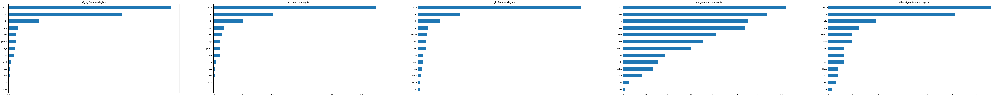

In [187]:
es_model_names = [col for col in ensemble_results.keys() if col not in ["bag_reg"]]
size = len(es_model_names)
rs, cs = (size//5+1, 5) if size>=5 else (size//3+1, 3)

plt.figure(figsize=(cs*20, rs*10))
ensemble_reg_models = dict()
for i, model_name in enumerate(es_model_names):
  if model_name in ["bag_reg"]: continue

  cur_model = ensemble_results[model_name]["tune_results"]["tuned_model"]
  ensemble_reg_models[model_name] = cur_model

  plt.subplot(rs,cs,i+1)
  pd.Series(cur_model.feature_importances_, X_train.columns).sort_values().plot(kind="barh")
  plt.title(f"{model_name} feature wieghts")

0.turn [rf_reg], plotting learning curve
1.turn [gbr], plotting learning curve
2.turn [xgbr], plotting learning curve
3.turn [lgbm_reg], plotting learning curve
4.turn [catboost_reg], plotting learning curve


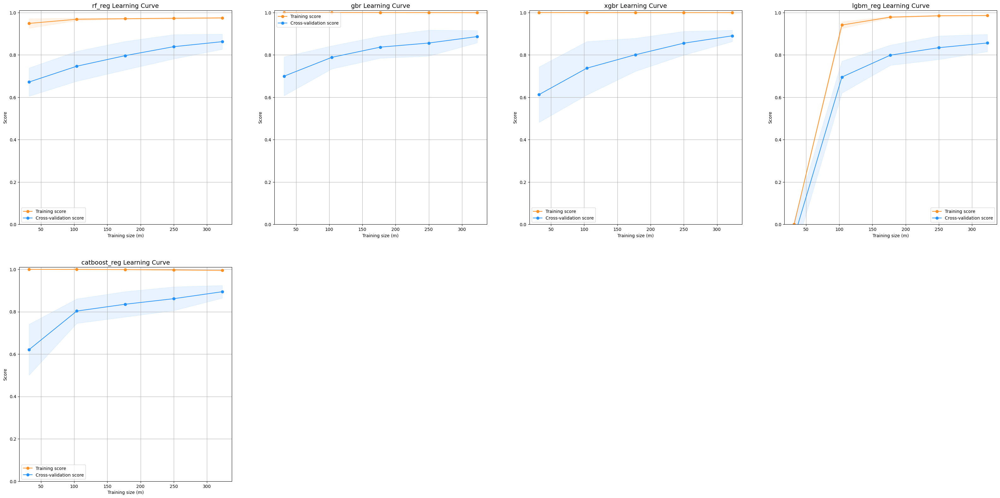

In [188]:
# Example Usage
model_size = len(ensemble_reg_models)
rs, cs = (model_size//2+1, 4 ) if model_size >= 4 else (model_size//2+1, 2)
lcs_params = {
    "cv" : ShuffleSplit(n_splits=10, test_size=0.2, random_state=42),
    "model_size": model_size,
    "rs":rs,
    "cs":cs,
    "figsize" : (cs*10,rs*10),
    "ylim" : (0.0, 1.01)
}

lc_plot  = get_learning_curve_stats(ensemble_reg_models, X_train, y_train,  **lcs_params)

## (4) Final Model

### Top models

In [189]:
# lin_results, lin_metric_summary
# lin_reg_results, lin_reg_metric_summary
# non_lin_results, non_lin_metric_summary
# ensemble_results, ensemble_metric_summary

In [190]:
all_results = [lin_results, lin_reg_results, non_lin_results, ensemble_results]

In [191]:
lin_models = pd.concat([lin_metric_summary, lin_reg_metric_summary])
lin_models = lin_models.sort_values(by=['RMSE','R2'], ascending=True)
lin_models

,MaxError,MeanAbsoluteError,MeanAbsolutePercentageError,MSE,RMSE,MAE,R2,ExplainedVariance
l1_reg,12.3,2.7,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306
l2_reg,12.3,2.7,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306
enet_reg,12.3,2.7,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306
lin_reg,12.3,2.7,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306


In [192]:
non_linear_model = pd.concat([non_lin_metric_summary, ensemble_metric_summary])
non_linear_model = non_linear_model.sort_values(by=['RMSE','R2'],  ascending=False)
non_linear_model

,MaxError,MeanAbsoluteError,MeanAbsolutePercentageError,MSE,RMSE,MAE,R2,ExplainedVariance
knn_reg,24.0,2.10,14.729846,30.463137,5.519342,3.464706,0.647607,0.662414
svr_reg,16.5,1.65,12.464594,13.441569,3.666274,2.550980,0.844510,0.851877
dt_params,13.5,2.20,13.343018,12.810196,3.579133,2.694118,0.851813,0.852981
lgbm_reg,12.0,1.65,10.433434,10.045490,3.169462,2.305882,0.883795,0.889463
gbr,10.0,1.50,10.155048,9.614118,3.100664,2.141176,0.888785,0.894613
catboost_reg,11.0,1.45,9.494598,9.008235,3.001372,2.119608,0.895794,0.904287
bag_reg,11.5,1.50,10.273731,8.372941,2.893603,2.135294,0.903143,0.906935
rf_reg,10.5,1.50,10.086696,8.096471,2.845430,2.094118,0.906341,0.908946
xgbr,10.5,1.35,9.260301,7.800392,2.792918,1.966667,0.909766,0.914817


In [193]:
non_linear_model.index

Index(['knn_reg', 'svr_reg', 'dt_params', 'lgbm_reg', 'gbr', 'catboost_reg',
       'bag_reg', 'rf_reg', 'xgbr'],
      dtype='object')

In [194]:
all_models = pd.concat([lin_metric_summary, lin_reg_metric_summary, non_lin_metric_summary, ensemble_metric_summary])
all_models = all_models.sort_values(by=['RMSE','R2'], ascending=True)
all_models

,MaxError,MeanAbsoluteError,MeanAbsolutePercentageError,MSE,RMSE,MAE,R2,ExplainedVariance
xgbr,10.5,1.35,9.260301,7.800392,2.792918,1.966667,0.909766,0.914817
rf_reg,10.5,1.50,10.086696,8.096471,2.845430,2.094118,0.906341,0.908946
bag_reg,11.5,1.50,10.273731,8.372941,2.893603,2.135294,0.903143,0.906935
catboost_reg,11.0,1.45,9.494598,9.008235,3.001372,2.119608,0.895794,0.904287
gbr,10.0,1.50,10.155048,9.614118,3.100664,2.141176,0.888785,0.894613
lgbm_reg,12.0,1.65,10.433434,10.045490,3.169462,2.305882,0.883795,0.889463
dt_params,13.5,2.20,13.343018,12.810196,3.579133,2.694118,0.851813,0.852981
svr_reg,16.5,1.65,12.464594,13.441569,3.666274,2.550980,0.844510,0.851877
l1_reg,12.3,2.70,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306
l2_reg,12.3,2.70,15.484242,19.551373,4.421693,3.272549,0.773833,0.775306


### Greedy Selection

In [195]:
best_model_name = all_models.iloc[0].name # "rf_reg"
best_model_name

'xgbr'

In [196]:
tuned_model, best_params = None, None
for results in all_results:
  if best_model_name in results:
      tuned_model = results[best_model_name]["tune_results"]["tuned_model"]
      best_params = results[best_model_name]["tune_results"]["best_params"]

In [197]:
tuned_model.score(X_test, y_test)

0.9060879712908423

In [198]:
from sklearn.model_selection import cross_val_score
cross_val_score(tuned_model, X_train, y_train, cv=10).mean(), cross_val_score(tuned_model, X_test, y_test, cv=10).mean()

(0.8966178423845369, 0.7536358592793906)

# (F) Saving & Downloading the model

### Saving the model

In [213]:
import pickle
model_save_path = 'xgbr_model.sav'
pickle.dump(tuned_model, open(model_save_path, 'wb'))

### Loading the model

In [214]:
loaded_model = pickle.load(open(model_save_path, 'rb'))

In [215]:
loaded_model.score(X_test, y_test)

0.9060879712908423

### Zipping the model
```python
import os 
zip_dst, src = f"{model_save_path}.zip", model_save_path
os.system(f"zip -r {zip_dst} {src}" )
```

### Downloading the model

In [ ]:
from google.colab import files
files.download(model_save_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# (G) Deployment as App

## APP (loading from file)

### Declerations & Util Funcs

In [216]:
!pip install gradio
import gradio as gr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 47.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.5/50.5 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.8/57.8 kB 8.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.1/200.1 kB 23.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.1/286.1 kB 32.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 61.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.5/129.5 kB 17.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.3/75.3 kB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.5/140.5 kB 17.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7

In [231]:
import pickle
import json 
import numpy as np
import pandas as pd

# File Paths
model_path = 'xgbr_model.sav'
component_config_path = "component_configs.json"
examples_path = "examples.pkl"

# predefined
feature_order = ['crim', 'zn', 'indus', 'chas', 'nox', 'rm', 'age', 'dis', 'rad', 'tax', 'ptratio', 'black', 'lstat']

# Loading the files
model = pickle.load(open(model_path, 'rb'))
with open(examples_path,"rb") as f: examples = pickle.load(f) 
feature_limitations = json.load(open(component_config_path, "r"))

In [232]:
def predict(*args):

  # preparing the input into convenient form
  features = pd.Series([*args], index=feature_order)
  features = np.array(features).reshape(-1,len(feature_order))

  # prediction
  pred = model.predict(features) # .predict_proba(features)

  return np.round(pred,5)

In [233]:
ex_data = [-0.4073334939537377, 0.7998646780590118, 4.93, 0.0, 0.428, 6.897, 54.3, 6.3361, 6.0, -0.6428510774698464, 16.6, 0.37910330788472546, 11.38]
predict(*ex_data)

array([22.27485], dtype=float32)

### Declerating the components

In [ ]:
import gradio as gr


inputs = list()
for col in feature_order:
  if col in feature_limitations["cat"].keys():
    
    # extracting the params
    vals = feature_limitations["cat"][col]["values"]
    def_val = feature_limitations["cat"][col]["def"]
    
    # creating the component
    inputs.append(gr.inputs.Dropdown(vals, default=def_val, label=col))
  else:
    
    # extracting the params
    min = feature_limitations["num"][col]["min"]
    max = feature_limitations["num"][col]["max"]
    def_val = feature_limitations["num"][col]["def"]
    
    # creating the component
    inputs.append(gr.inputs.Slider(minimum=min, maximum=max, default=def_val, label=col) )


/usr/local/lib/python3.8/dist-packages/gradio/inputs.py:89: UserWarning: Usage of gradio.inputs is deprecated, and will not be supported in the future, please import your component from gradio.components
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/gradio/deprecation.py:40: UserWarning: `optional` parameter is deprecated, and it has no effect
  warnings.warn(value)


### Launching the demo app

In [252]:
import gradio as gr
# Creating application
gr.Interface(predict, inputs, "number", examples = examples).launch()

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Note: opening Chrome Inspector may crash demo inside Colab notebooks.

To create a public link, set `share=True` in `launch()`.


<IPython.core.display.Javascript object>

## Manuels (with out file, code form)

### Declerations & Util Funcs

### Extracting the input params

In [218]:
ex_obs_fea, ex_obs_tar = dict(X_test.iloc[0,:]), y_test.iloc[0]
ex_obs_fea, ex_obs_tar

({'crim': -0.41660844059273905,
  'zn': 1.121761438741297,
  'indus': 2.95,
  'chas': 0.0,
  'nox': 0.428,
  'rm': 7.024,
  'age': 15.8,
  'dis': 5.4011,
  'rad': 3.0,
  'tax': -0.9279366560848703,
  'ptratio': 18.3,
  'black': 0.42701755390888174,
  'lstat': 1.98},
 34.9)

In [219]:
def_vals = ex_obs_fea.copy()
def_vals

{'crim': -0.41660844059273905,
 'zn': 1.121761438741297,
 'indus': 2.95,
 'chas': 0.0,
 'nox': 0.428,
 'rm': 7.024,
 'age': 15.8,
 'dis': 5.4011,
 'rad': 3.0,
 'tax': -0.9279366560848703,
 'ptratio': 18.3,
 'black': 0.42701755390888174,
 'lstat': 1.98}

In [220]:
feature_order = ex_obs_fea.keys()
feature_order

dict_keys(['crim', 'zn', 'indus', 'chas', 'nox', 'rm', 'age', 'dis', 'rad', 'tax', 'ptratio', 'black', 'lstat'])

In [246]:
predict(*list(def_vals.values()))

array([37.31038], dtype=float32)

In [222]:
ex_obs_fea

{'crim': -0.41660844059273905,
 'zn': 1.121761438741297,
 'indus': 2.95,
 'chas': 0.0,
 'nox': 0.428,
 'rm': 7.024,
 'age': 15.8,
 'dis': 5.4011,
 'rad': 3.0,
 'tax': -0.9279366560848703,
 'ptratio': 18.3,
 'black': 0.42701755390888174,
 'lstat': 1.98}

In [223]:
ex_obs_fea.values()

dict_values([-0.41660844059273905, 1.121761438741297, 2.95, 0.0, 0.428, 7.024, 15.8, 5.4011, 3.0, -0.9279366560848703, 18.3, 0.42701755390888174, 1.98])

In [224]:
import numpy as np

num_limitations = {}
for col in df.select_dtypes(exclude=["object",bool]).drop(columns=["medv"]).columns:
  num_limitations[col] = {
          "min": np.floor(df[col].min()),
          "max": np.ceil(df[col].max()),
          "def": np.floor(ex_obs_fea[col])
      }

In [225]:
total_limitations = {
    "num":num_limitations,
    "cat":{}
}

In [226]:
feature_limitations = total_limitations.copy()
# removing target classes
#del feature_limitations["cat"]["Loan_Status"]

In [227]:
component_config_path = "component_configs.json"
with open(component_config_path,"w+") as f: json.dump(feature_limitations, f)

In [228]:
print(json.dumps(feature_limitations, indent=4))

{
    "num": {
        "crim": {
            "min": -1.0,
            "max": 1.0,
            "def": -1.0
        },
        "zn": {
            "min": -1.0,
            "max": 2.0,
            "def": 1.0
        },
        "indus": {
            "min": 0.0,
            "max": 28.0,
            "def": 2.0
        },
        "chas": {
            "min": 0.0,
            "max": 1.0,
            "def": 0.0
        },
        "nox": {
            "min": 0.0,
            "max": 1.0,
            "def": 0.0
        },
        "rm": {
            "min": 3.0,
            "max": 9.0,
            "def": 7.0
        },
        "age": {
            "min": 2.0,
            "max": 100.0,
            "def": 15.0
        },
        "dis": {
            "min": 1.0,
            "max": 13.0,
            "def": 5.0
        },
        "rad": {
            "min": 1.0,
            "max": 24.0,
            "def": 3.0
        },
        "tax": {
            "min": -2.0,
            "max": 2.0,
            "def"

### Extracting examples

In [251]:
examples = [list(record) for record in X_test.iloc[1:5,:].values]
examples

[[-0.40464178108347293,
  -0.48772236467012914,
  10.59,
  0.0,
  0.489,
  5.891,
  22.3,
  3.9454,
  4.0,
  -0.7794545838895454,
  18.6,
  0.4410519326070325,
  10.87],
 [-0.4171437574627441,
  1.121761438741297,
  1.25,
  0.0,
  0.429,
  6.939,
  34.5,
  8.7921,
  1.0,
  -0.43497617639639147,
  19.7,
  0.363753206183623,
  5.89],
 [-0.3441009342828751,
  0.3706689971492982,
  3.97,
  0.0,
  0.647,
  6.842,
  100.0,
  2.0107,
  5.0,
  -0.8566652614311143,
  13.0,
  0.38655907156811825,
  6.9],
 [-0.3535690604880087,
  -0.48772236467012914,
  6.2,
  0.0,
  0.507,
  8.337,
  73.3,
  3.8384,
  8.0,
  -0.6012760972551554,
  17.4,
  0.3205536342533769,
  2.47]]

In [253]:
import pickle
with open("examples.pkl","wb") as f: pickle.dump(examples, f)
with open("examples.pkl","rb") as f: examples = pickle.load(f) 

### Declerating the components

In [229]:
import gradio as gr


inputs = list()
for col in feature_order:
  if col in feature_limitations["cat"].keys():
    
    # extracting the params
    vals = feature_limitations["cat"][col]["values"]
    def_val = feature_limitations["cat"][col]["def"]
    
    # creating the component
    inputs.append(gr.inputs.Dropdown(vals, default=def_val, label=col))
  else:
    
    # extracting the params
    min = feature_limitations["num"][col]["min"]
    max = feature_limitations["num"][col]["max"]
    def_val = feature_limitations["num"][col]["def"]
    
    # creating the component
    inputs.append(gr.inputs.Slider(minimum=min, maximum=max, default=def_val, label=col) )


### Launching the demo app

In [230]:
import gradio as gr
# Creating application
gr.Interface(predict, inputs, "number").launch()

NameError: ignored